# Машинное обучение, ФКН ВШЭ

## Практическое задание 2. Exploratory Data Analysis и линейная регрессия

### Общая информация
Дата выдачи: 12.10.2024

Мягкий дедлайн: 23:59MSK 27.10.2024

Жесткий дедлайн: 23:59MSK 31.10.2024

### О задании
В этом задании мы попытаемся научиться анализировать данные и выделять из них полезные признаки. Мы также научимся пользоваться `sklearn`, а заодно привыкнем к основным понятиям машинного обучения.

### Оценивание и штрафы
Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов. Проверяющий имеет право снизить оценку за неэффективную реализацию или неопрятные графики.

**Обратите внимание**, что в каждом разделе домашнего задания есть оцениваниемые задачи и есть вопросы. Вопросы дополняют задачи и направлены на то, чтобы проинтерпретировать или обосновать происходящее. Код без интерпретации не имеет смысла, поэтому отвечать на вопросы обязательно — за отсутствие ответов мы будем снижать баллы за задачи. Если вы ответите на вопросы, но не напишете корректный код к соответствующим оцениваемым задачам, то баллы за такое выставлены не будут.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

### Формат сдачи
Задания сдаются через систему Anytask. Инвайт можно найти на странице курса. Присылать необходимо ноутбук с выполненным заданием. Сам ноутбук называйте в формате homework-practice-02-linregr-Username.ipynb, где Username — ваша фамилия.

Для удобства проверки самостоятельно посчитайте свою максимальную оценку (исходя из набора решенных задач) и укажите ниже.

Оценка: 12

В этом ноутбуке используется библиотека `folium` для визуализации карт. Она работает в google colab!

In [7]:
!pip install folium

In [8]:
import folium

m = folium.Map(location=(50.97178, 9.79418), zoom_start=15)

m

Если вы всё сделали правильно, то выше должна открыться карта

### 📌 **Памятка по дз2**

Обрабатывать данные можно любым способом (`polars`, `pandas`, `pyspark`, ...), который вам нравится и запускается в ноутбуке, и любой библиотекой для визуализации (`matplotlib`, `seaborn`, `plotly`, ...). Пользуйтесь на здоровье, но!

> Учтите, что `polars` всё ещё молодой и не все библиотеки его поддерживают. `sklearn` во многом уже работает, но на всякий случай не стесняйтесь пользоваться методами `pl.DataFrame.to_pandas()` или `pl.DataFrame.to_numpy()`    

> Впрочем, `pandas` тоже не лишён проблем. `sklearn` принимает `pd.DataFrame` почти везде, проблемы очень редки, но если вдруг возникнет какая-то беда с шейпами, или ещё какой-нибудь казус, а вы уверены, что всё правильно, пользуйтесь `pd.DataFrame.to_numpy()`. Это не всегда решает проблему, но часто помогает понять, что на самом деле не так. При желании можно передавать и `Iterable`, и sparse-матрицы

> Графики должны быть понятные, читаемые и пр. Консультируйтесь с памяткой из дз1 в задании на график

> Для воспроизводимости результатов не забывайте пользоваться `np.random.seed(...)`, при необходимости чистите мусор `gc.collect()`, лучше в каждой ячейке

> Все результаты должны быть получены в ноутбуке. На каждый **Вопрос** долен быть дан **Ответ** (письменно (в Markdown например) или кодом)

In [9]:
import math
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns

# sklearn
from sklearn.model_selection import train_test_split

# warnings.filterwarnings("ignore")

## Часть 0. Подготовка (1 балл)

**Задание 1 (1 балл)**. Мы будем работать с данными из соревнования [New York City Taxi Trip Duration](https://www.kaggle.com/c/nyc-taxi-trip-duration/overview), в котором нужно было предсказать длительность поездки на такси. Скачайте обучающую выборку из этого соревнования и загрузите ее:

In [10]:
!pip install kaggle
!sudo apt-get install -y p7zip-full

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
p7zip-full is already the newest version (16.02+dfsg-8).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


In [11]:
# Для загрузки датасета нужно добавить свой kaggle.json в файлы (своим делиться не буду)

!sudo ln -sf ~/.local/bin/kaggle /usr/bin/kaggle

!mkdir -p ~/.kaggle
!touch ~/.kaggle/kaggle.json

!cp kaggle.json ~/.kaggle/

!chmod 600 ~/.kaggle/kaggle.json

!kaggle competitions download -c nyc-taxi-trip-duration -f train.zip
#!kaggle competitions download -c nyc-taxi-trip-duration -f test.zip

!mkdir -p data
!7z x train.zip -y -o./data/
!7z x test.zip -y -o./data/

!rm train.zip
# !rm test.zip

 99% 62.0M/62.9M [00:01<00:00, 50.4MB/s]
100% 62.9M/62.9M [00:01<00:00, 54.4MB/s]

7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan         1 file, 65967663 bytes (63 MiB)

Extracting archive: train.zip
--
Path = train.zip
Type = zip
Physical Size = 65967663

  0%      1% - train.csv                  3% - train.csv                  5% - train.csv                  7% - train.csv                  9% - train.csv                 11% - train.csv                 13% - train.csv                 16% - train.csv                 18

In [12]:
train = pd.read_csv("data/train.csv")
# test = pd.read_csv("data/test.csv")
train

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435
...,...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,2016-04-08 13:31:04,2016-04-08 13:44:02,4,-73.982201,40.745522,-73.994911,40.740170,N,778
1458640,id1049543,1,2016-01-10 07:35:15,2016-01-10 07:46:10,1,-74.000946,40.747379,-73.970184,40.796547,N,655
1458641,id2304944,2,2016-04-22 06:57:41,2016-04-22 07:10:25,1,-73.959129,40.768799,-74.004433,40.707371,N,764
1458642,id2714485,1,2016-01-05 15:56:26,2016-01-05 16:02:39,1,-73.982079,40.749062,-73.974632,40.757107,N,373


Обратите внимание на колонки `pickup_datetime` и `dropoff_datetime`. `dropoff_datetime` был добавлена организаторами только в обучающую выборку, то есть использовать эту колонку нельзя, давайте удалим ее. В `pickup_datetime` записаны дата и время начала поездки. Чтобы с ней было удобно работать, давайте преобразуем даты в `datetime`-объекты

In [13]:
if "dropoff_datetime" in train.columns:
    train = train.drop(columns=["dropoff_datetime"])
train["pickup_datetime"] = pd.to_datetime(train["pickup_datetime"])

train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,435
...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,2016-04-08 13:31:04,4,-73.982201,40.745522,-73.994911,40.740170,N,778
1458640,id1049543,1,2016-01-10 07:35:15,1,-74.000946,40.747379,-73.970184,40.796547,N,655
1458641,id2304944,2,2016-04-22 06:57:41,1,-73.959129,40.768799,-74.004433,40.707371,N,764
1458642,id2714485,1,2016-01-05 15:56:26,1,-73.982079,40.749062,-73.974632,40.757107,N,373


В колонке `trip_duration` записано целевое значение, которое мы хотим предсказывать. Давайте посмотрим на распределение таргета в обучающей выборке. Для этого нарисуйте его гистограмму:

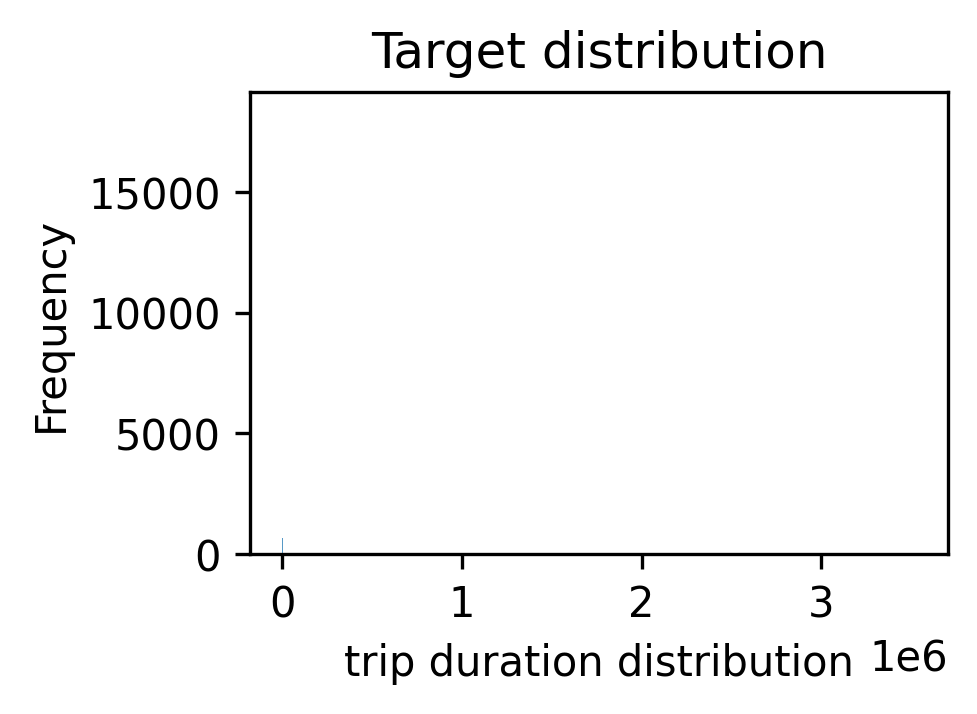

In [14]:
_, ax = plt.subplots(figsize=(3, 2), dpi=300)

sns.histplot(train["trip_duration"])  # .sample(n=100000, random_state=123))

plt.title("Target distribution")

plt.ylabel("Frequency")
plt.xlabel("trip duration distribution")

plt.show()

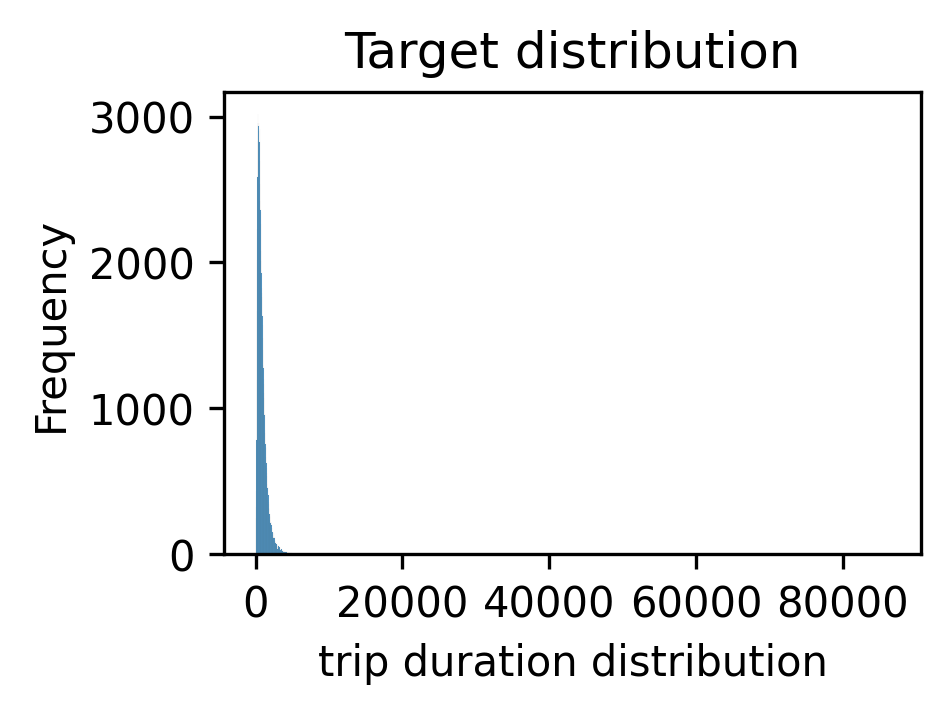

In [15]:
# Возьму часть выборки, чтобы хоть что-то увидеть
_, ax = plt.subplots(figsize=(3, 2), dpi=300)


sns.histplot(train["trip_duration"].sample(n=100000, random_state=123))

plt.title("Target distribution")

plt.ylabel("Frequency")
plt.xlabel("trip duration distribution")

plt.show()

**Вопрос**: Что можно сказать о целевой переменной по гистограмме её значений?

В целом практически все значения распределены около нуля, но есть явные выбросы в (значительно) большую строну. В целом данные очень сильно рассредоточены от 0 до миллионов

В соревновании в качестве метрики качества использовалось RMSLE:
$$\text{RMSLE}(X, y, a) = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(y_i + 1)} - \log{(a(x_i) + 1)}\big)^2}$$

**Вопрос**: Как вы думаете, почему авторы соревнования выбрали именно RMSLE, а не RMSE?

RMSLE был выбран вместо RMSE, поскольку данные очень сильно рассредоточены (от 0 до миллионов). То есть важны будут не сами значения, а количество знаков перед ними (порядок). Это позволяет не иметь огромные ошибки на больших числах, сохраняя баланс между ошибками на малых и больших значениях, снижая влияние выбросов. Также логарифмическое преобразование сглаживает масштаб данных и может "упростить работу" линейным моделям.

На семинаре мы рассматривали несколько моделей линейной регрессии в `sklearn`, но каждая из них оптимизировала среднеквадратичную ошибку (MSE), а не RMSLE. Давайте проделаем следующий трюк: будем предсказывать не целевую переменную, а ее *логарифм*. Обозначим $\hat{y}_i = \log{(y_i + 1)}$ — модифицированный таргет, а $\hat{a}(x_i)$ — предсказание модели, которая обучалась на $\hat{y}_i$, то есть логарифм таргета. Чтобы предсказать исходное значение, мы можем просто взять экспоненту от нашего предсказания: $a(x_i) = \exp(\hat{a}(x_i)) - 1$.

**Вопрос**: Покажите, что оптимизация RMSLE для модели $a$ эквивалентна оптимизации MSE для модели $\hat{a}$.

**Доказательство**:

$$
RMSLE(X, y, a) = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(y_i + 1)} - \log{(a(x_i) + 1)}\big)^2}
$$

Подставим $ a(x_i) = \exp(\hat{a}(x_i)) - 1$

$$
RMSLE(X, y, a) =\sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(y_i + 1)} - \log{(\exp(\hat{a}(x_i)))}\big)^2}=\sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(y_i + 1)} - \hat{a}(x_i)\big)^2}
$$

Аналогично подставим $\hat{y}_i = \log{(y_i + 1)}$

$$
MSE(X, \hat{y}, \hat{a}) = \frac{1}{\ell}\sum_{i=1}^{\ell} \big((\hat{y}_i - \hat{a}(x_i)\big)^2 = \frac{1}{\ell}\sum_{i=1}^{\ell} \big((\log{(y_i + 1)} - \hat{a}(x_i)\big)^2
$$

Пусть $t = \frac{1}{\ell}\sum_{i=1}^{\ell} \big((\log{(y_i + 1)} - \hat{a}(x_i)\big)^2$, тогда

$$
MSE(X, \hat{y}, \hat{a}) = t
$$

$$
RMSLE(X, y, a) =\sqrt{t} = \sqrt{MSE(X, \hat{y}, \hat{a})}
$$



Корень не меняет глобальный минимум функции, значит оптимизации эквивалентны

Итак, мы смогли свести задачу оптимизации RMSLE к задаче оптимизации MSE, которую мы умеем решать! Кроме того, у логарифмирования таргета есть еще одно полезное свойство. Чтобы его увидеть, добавьте к нашей выборке колонку `log_trip_duration` (воспользуйтесь `np.log1p`) и нарисуйте гистограмму модифицированного таргета по обучающей выборке. Удалите колонку со старым таргетом.

In [16]:
train["log_trip_duration"] = np.log1p(train["trip_duration"])
#train = train.drop(["trip_duration"]) # Пока не сану удалять trip_duration. Он ещё может понадобитсья
train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,log_trip_duration
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,455,6.122493
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,663,6.498282
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,7.661527
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,429,6.063785
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,435,6.077642
...,...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,2016-04-08 13:31:04,4,-73.982201,40.745522,-73.994911,40.740170,N,778,6.658011
1458640,id1049543,1,2016-01-10 07:35:15,1,-74.000946,40.747379,-73.970184,40.796547,N,655,6.486161
1458641,id2304944,2,2016-04-22 06:57:41,1,-73.959129,40.768799,-74.004433,40.707371,N,764,6.639876
1458642,id2714485,1,2016-01-05 15:56:26,1,-73.982079,40.749062,-73.974632,40.757107,N,373,5.924256


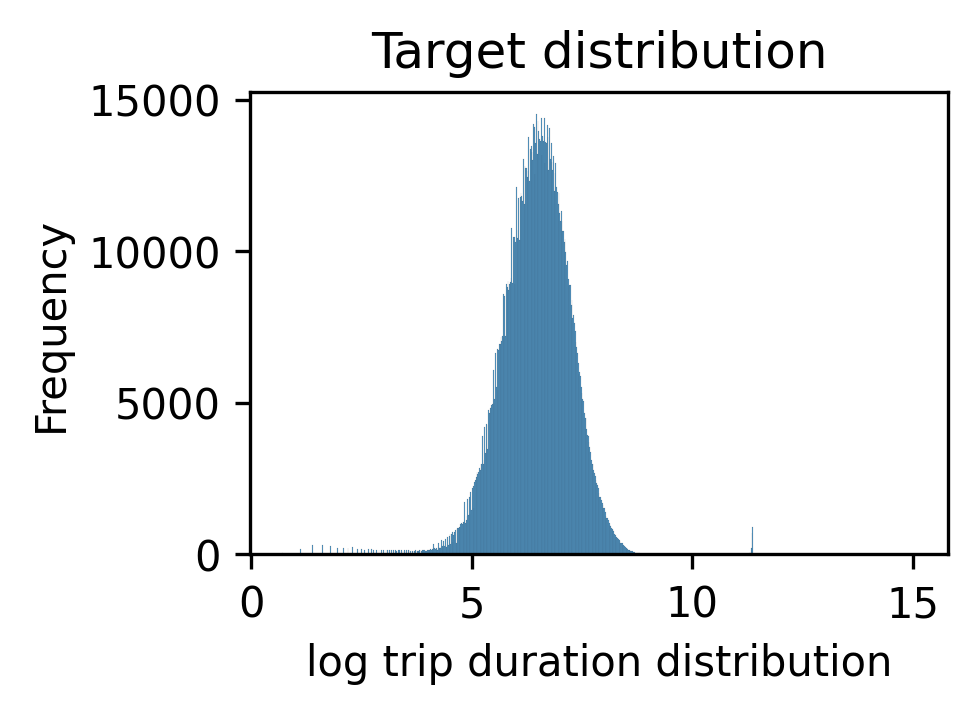

In [17]:
_, ax = plt.subplots(figsize=(3, 2), dpi=300)

plt.subplot(1, 1, 1)

sns.histplot(train["log_trip_duration"])  # .sample(n=100000, random_state=123))

plt.title("Target distribution")

plt.ylabel("Frequency")
plt.xlabel("log trip duration distribution")

plt.show()

Как нам и показывали на семинаре, после логарифмирования данные стали похожи на нормальное распределение

Чтобы иметь некоторую точку отсчета, давайте посчитаем значение метрики при наилучшем константном предсказании:

In [18]:
def rmsle(log1p_y_true, log1p_y_pred):
    return np.sqrt(np.mean(np.square(log1p_y_true - log1p_y_pred)))



rmsle_best_const = rmsle(train["log_trip_duration"], train["log_trip_duration"].mean())  # Для mse (и, следовательно rmsle) лучшее константное значение - это среднее

print(rmsle_best_const)
assert np.allclose(rmsle_best_const, 0.79575, 1e-4)

0.7957592365411509


## Часть 1. Изучаем `pickup_datetime` (2 балла)

**Задание 2 (0.25 баллов)**. Для начала давайте посмотрим, сколько всего было поездок в каждый из дней. Постройте график зависимости количества поездок от дня в году:

In [19]:
# Для начала посчитаю количество поездок в день с помощью группировки

date_to_freq = train.groupby(train["pickup_datetime"].dt.date)["id"].count()
date_to_freq

,id
pickup_datetime,
2016-01-01,7162
2016-01-02,6512
2016-01-03,6353
2016-01-04,6725
2016-01-05,7204
...,...
2016-06-26,7084
2016-06-27,7311
2016-06-28,7253


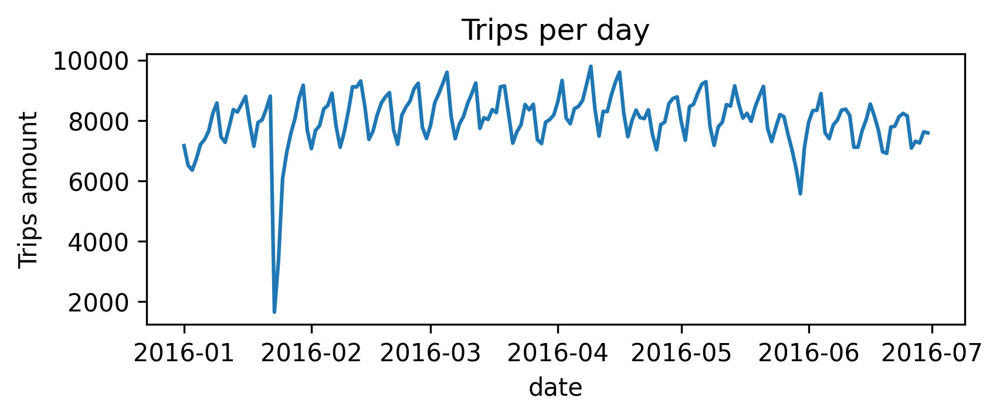

In [20]:
_, ax = plt.subplots(figsize=(6, 2), dpi=300)

sns.lineplot(x=date_to_freq.index, y=date_to_freq.values, ax=ax)

ax.set_title("Trips per day")

ax.set_ylabel("Trips amount")
ax.set_xlabel("date")

plt.show()

In [21]:
date_to_freq[date_to_freq.values < 6200]

,id
pickup_datetime,
2016-01-23,1648
2016-01-24,3383
2016-01-25,6084
2016-05-30,5570


**Вопрос**: Вы, вероятно, заметили, что на графике есть 2 периода с аномально маленькими количествами поездок. Вычислите, в какие даты происходили эти скачки вниз и найдите информацию о том, что происходило в эти дни в Нью-Йорке.

**Ответ**:
2016-01-23 - Выпало аномальное количество снега (произошёл шторм), поэтому "Запрет на поездки был введен для Нью-Йорка и Ньюарка, штат Нью-Джерси, на 23-24 января". К 25 числу количество поездок уже почти восстановилось, но ещё было было аномально низким. (https://en.wikipedia.org/wiki/January_2016_United_States_blizzard)

В ночь с 29 по 30 апреля (2016-05-30) в городе было 3 перестрелки и к утру преступников не задержали, так что некоторые люди боялись выходить на улицу. (https://nypost.com/2016/05/30/overnight-shootings-leave-six-injured/)

Ещё и кенгуру пинал женщин с двух ног (https://nypost.com/2016/05/30/kangaroo-jump-kicks-woman-rupturing-her-breast-implants/)


Нарисуйте графики зависимости количества поездок от дня недели и от часов в сутках:

In [22]:
week_day_to_freq = train.groupby(train["pickup_datetime"].dt.dayofweek)["id"].count()
week_day_to_freq

,id
pickup_datetime,
0,187418
1,202749
2,210136
3,218574
4,223533
5,220868
6,195366


In [23]:
day_time_to_freq = train.groupby(train["pickup_datetime"].dt.hour)["id"].count()
day_time_to_freq

,id
pickup_datetime,
0,53248
1,38571
2,27972
3,20895
4,15792
5,15002
6,33248
7,55600
8,67053


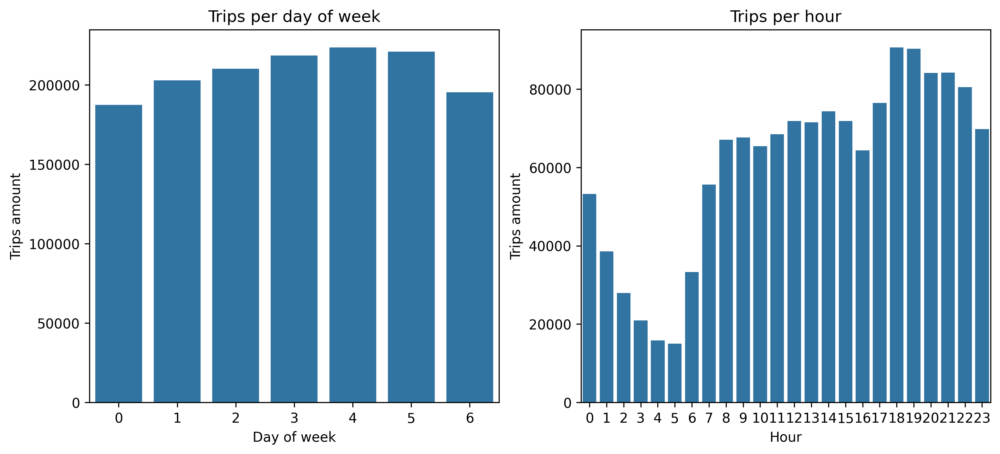

In [24]:
_, ax = plt.subplots(1, 2, figsize=(12, 5), dpi=300)

sns.barplot(x=week_day_to_freq.index, y=week_day_to_freq.values, ax=ax[0])
sns.barplot(x=day_time_to_freq.index, y=day_time_to_freq.values, ax=ax[1])

ax[0].set_title("Trips per day of week")
ax[1].set_title("Trips per hour")


ax[0].set_ylabel("Trips amount")
ax[0].set_xlabel("Day of week")

ax[1].set_ylabel("Trips amount")
ax[1].set_xlabel("Hour")

plt.show()

0 - Это понедельник
Больше всего заказов в пятницу и субботу (люди едут отдыхать)

Больше всего заказов в вечернее время (люди опять едут отдыхать)
Ночью заказов мало (все спят)

**Задание 3 (0.5 баллов)**. Нарисуйте на одном графике зависимости количества поездок от часа в сутках для разных месяцев (разные кривые, соответствующие разным месяцам, окрашивайте в разные цвета, поищите, как это делается). Аналогично нарисуйте зависимости количества поездок от часа в сутках для разных дней недели.

In [25]:
# Создам временные столбцы с self-crafted features из дат (без этого не сгруппировать)

train["month"] = train["pickup_datetime"].dt.month
train["dayofweek"] = train["pickup_datetime"].dt.dayofweek
train["hour"] = train["pickup_datetime"].dt.hour

In [26]:
hour_hue_month_to_freq = train.groupby(by=["hour", "month"])["id"].count().reset_index()
hour_hue_month_to_freq

,hour,month,id
0,0,1,8330
1,0,2,8445
2,0,3,8992
3,0,4,9185
4,0,5,9146
...,...,...,...
139,23,2,11042
140,23,3,12172
141,23,4,12503
142,23,5,11928


In [27]:
hour_hue_week_day_to_freq = train.groupby(by=["hour", "dayofweek"])["id"].count().reset_index()
hour_hue_week_day_to_freq

,hour,dayofweek,id
0,0,0,4299
1,0,1,4506
2,0,2,5327
3,0,3,6299
4,0,4,8779
...,...,...,...
163,23,2,9735
164,23,3,11715
165,23,4,13181
166,23,5,13166


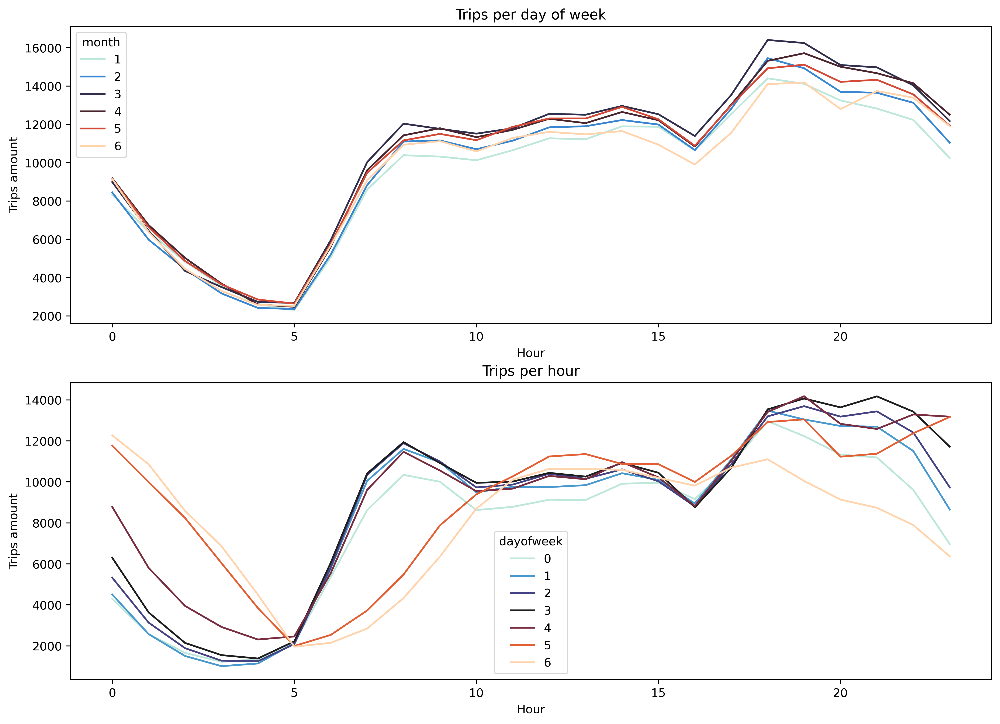

In [28]:
_, ax = plt.subplots(2, 1, figsize=(14, 10), dpi=400)

sns.lineplot(data = hour_hue_month_to_freq, x="hour",  y="id", hue="month", palette="icefire", ax=ax[0])
sns.lineplot(data = hour_hue_week_day_to_freq, x="hour",  y="id", hue="dayofweek", palette="icefire", ax=ax[1])

ax[0].set_title("Trips per day of week")
ax[1].set_title("Trips per hour")


ax[0].set_ylabel("Trips amount")
ax[0].set_xlabel("Hour")

ax[1].set_ylabel("Trips amount")
ax[1].set_xlabel("Hour")

plt.show()

**Вопрос**: Какие выводы можно сделать, основываясь на графиках выше? Выделяются ли какие-нибудь дни недели? Месяца? Время суток? С чем это связано?

**Ответ**: Вне зависимости от месяца пики и спады заказов такси не меняются
Самый активный месяц - март (возможно погода становится более благоприятной и люди по весне чаще куда-то выбираются), а самый неактивный месяц - май (возможно жители Нью-Йорка улетают на отдых в Анапу, разъезжаются в свои субурбии садить картошку).

По времени недели можно явно разделить на будни и выходные. По будням люди часто используют такси до и после работы (час пик).
В выходные же люди склонны пользоваться такси в ночное время и начинают активничать на 2-3 часа позже, после 10 часов и до самой поздней ночи (не считая ночи с воскресенья на понедельник). В целом в любой месяц в 5 утра почти нет заказов, а 18 часов самый пик активности.

**Задание 4 (0.5 баллов)**. Разбейте выборку на обучающую и тестовую в отношении 7:3 (используйте `train_test_split` из `sklearn`). По обучающей выборке нарисуйте график зависимости среднего логарифма времени поездки от дня недели. Затем сделайте то же самое, но для часа в сутках и дня в году.

In [29]:
print(train.columns.tolist())

['id', 'vendor_id', 'pickup_datetime', 'passenger_count', 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag', 'trip_duration', 'log_trip_duration', 'month', 'dayofweek', 'hour']


In [30]:
# У нас же в данных уже есть разбиение выборки на трейн и тест? Видимо его можно протестировать только на kaggle, так что представлю что его нет.
X, y = train.drop(columns=["trip_duration", "log_trip_duration"]), train["log_trip_duration"]

# Буду стратифицировать по бинам, чтобы распределение таргета было одинаковым в тесте и трейне
y_bins = pd.qcut(x=y, q=10, labels=False, duplicates="drop")

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y_bins, random_state=123)
X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14
...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9


In [31]:
y

,log_trip_duration
0,6.122493
1,6.498282
2,7.661527
3,6.063785
4,6.077642
...,...
1458639,6.658011
1458640,6.486161
1458641,6.639876
1458642,5.924256


In [32]:
 # Чтобы сгруппировать данные придётся снова временно вернуть таргет в матрицу с данными)
temp_train = X_train.copy(deep=True)
temp_train["log_trip_duration"] = y
temp_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,log_trip_duration
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,4.969813
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,7.063048
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,6.335054
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,7.074117
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,6.865891
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9,6.867974
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10,6.863803
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8,4.867534
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9,7.569928


In [33]:
mean_log_from_dayofweek = temp_train.groupby(by=["dayofweek"])["log_trip_duration"].mean()
mean_log_from_dayofweek

,log_trip_duration
dayofweek,
0,6.427574
1,6.492168
2,6.516131
3,6.528147
4,6.498141
5,6.417033
6,6.378667


In [34]:
mean_log_from_hour = temp_train.groupby(by=["hour"])["log_trip_duration"].mean()
mean_log_from_hour

,log_trip_duration
hour,
0,6.422642
1,6.372454
2,6.328213
3,6.319487
4,6.332971
5,6.239908
6,6.187573
7,6.345044
8,6.470332


In [35]:
mean_log_from_date= temp_train.groupby(temp_train["pickup_datetime"].dt.date)["log_trip_duration"].mean()
mean_log_from_date

,log_trip_duration
pickup_datetime,
2016-01-01,6.333112
2016-01-02,6.312881
2016-01-03,6.317083
2016-01-04,6.318702
2016-01-05,6.344006
...,...
2016-06-26,6.455609
2016-06-27,6.467648
2016-06-28,6.498933


In [36]:
import gc

gc.collect()

4015

In [37]:
import datetime

_, ax = plt.subplots(3, 1, figsize=(18, 10), dpi=650)

sns.lineplot(x = mean_log_from_dayofweek.index, y=mean_log_from_dayofweek.values, ax=ax[0])
sns.lineplot(x = mean_log_from_hour.index, y=mean_log_from_hour.values, ax=ax[1])
sns.lineplot(x = mean_log_from_date.index, y=mean_log_from_date.values, ax=ax[2])

ax[0].set_title("trip duration mean per day of week", pad=20)
ax[1].set_title("trip duration mean per hour", pad=20)
ax[2].set_title("trip duration mean per date", pad=20)

ax[0].set_ylabel("log trip duration")
ax[0].set_xlabel("day of week")

ax[1].set_ylabel("log trip duration")
ax[1].set_xlabel("Hour")

ax[2].set_ylabel("log trip duration")
ax[2].set_xlabel("date")

ax[0].set_ylim(3)
ax[1].set_ylim(3)
ax[2].set_ylim(3)

ax[2].axvline(x=datetime.datetime.strptime("2016-01-23", "%Y-%m-%d"), color='r', linestyle='--')
ax[2].axvline(x=datetime.datetime.strptime("2016-05-30", "%Y-%m-%d"), color='r', linestyle='--')

plt.tight_layout(pad=2.0)

plt.show()

In [38]:
del temp_train

**Вопрос**: Похожи ли графики зависимости таргета от дня недели и от часа в сутках на аналогичные графики для количества поездок? Почему? Что происходит со средним таргетом в те два аномальных периода, что мы видели выше? Почему так происходит? Наблюдаете ли вы какой-нибудь тренд на графике зависимости `log_trip_duration` от номера дня в году?

**Ответ** Нет, вообще не похожи. Потому что, видимо, время заказа такси не зависит отвремени в пути. Никакого тренда на графиках не вижу, разве что волнистую линию времени поездки, возможно это связано с выходными (на графике от дня недели тоже есть небольшие изменения)
В те два аномальных периода (2016-01-23 и 2016-05-30) не было явного увеличения среднего времени. Разве что после бури 2016-01-23, через несколько дней, среднее время пути увеличилось (возможно из-за заснеженности дорог)

Добавьте следующие признаки на основе `pickup_datetime`:
1. День недели
2. Месяц
3. Час
4. Является ли период аномальным (два бинарных признака, соответствующие двум аномальным периодам)
5. Номер дня в году

In [39]:
# Первые 3 я уже добавил до этого
X_train["dayofyear"] = X_train["pickup_datetime"].dt.dayofyear
X_test["dayofyear"] = X_test["pickup_datetime"].dt.dayofyear
X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,114
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,77
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,150
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,49
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,164
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9,146
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10,165
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8,132
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9,179


In [40]:
X_train["is_anomaly"] = (((X_train["pickup_datetime"].dt.date >= pd.to_datetime("2016-01-23").date()) &
        (X_train["pickup_datetime"].dt.date <= pd.to_datetime("2016-01-25").date())) |
        (X_train["pickup_datetime"].dt.date == pd.to_datetime("2016-05-30").date()))
X_test["is_anomaly"] = (((X_test["pickup_datetime"].dt.date >= pd.to_datetime("2016-01-23").date()) &
        (X_test["pickup_datetime"].dt.date <= pd.to_datetime("2016-01-25").date())) |
        (X_test["pickup_datetime"].dt.date == pd.to_datetime("2016-05-30").date()))
X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear,is_anomaly
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,114,False
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,77,False
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,150,False
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,49,False
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,164,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9,146,False
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10,165,False
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8,132,False
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9,179,False


Итак, мы уже создали некоторое количество признаков.

**Вопрос**: Какие из признаков _стоит рассматривать в этой задаче_   как категориальные, а какие - как численные? Почему?

In [41]:
X_train.columns

Index(['id', 'vendor_id', 'pickup_datetime', 'passenger_count',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'store_and_fwd_flag', 'month', 'dayofweek', 'hour',
       'dayofyear', 'is_anomaly'],
      dtype='object')

Не используются
id - не несёт информации
pickup_datetime - заменяется на 'month', 'dayofweek', 'hour', 'dayofyear', 'is_anomaly'

Категориальные:
'vendor_id' - есть всего два вендора, скорее всего не влияет, но это категория
'store_and_fwd_flag' - тоже 2 категории
'month', 'dayofweek', 'hour', 'dayofyear', 'is_anomaly' - категории дат

Числа:
'passenger_count' - Может быть лейбл энкодер или категориальный, но оставлю числом, так как числа, на удивление, увеличиваются с увеличением числа
 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude' - широты, долготы. Явные числа



**Задание 5 (0.75 баллов)**. Обучите `Ridge`-регрессию с параметрами по умолчанию, закодировав все категориальные признаки с помощью `OneHotEncoder`. Численные признаки отмасштабируйте с помощью `StandardScaler`. Используйте только признаки, которые мы выделили в этой части задания.

In [42]:
X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear,is_anomaly
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,114,False
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,77,False
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,150,False
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,49,False
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,164,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9,146,False
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10,165,False
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8,132,False
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9,179,False


In [43]:
X_train["vendor_id"] = X_train["vendor_id"].astype("category")
X_train["store_and_fwd_flag"] = X_train["store_and_fwd_flag"].astype("category")
X_train["month"] = X_train["month"].astype("category")
X_train["dayofweek"] = X_train["dayofweek"].astype("category")
X_train["hour"] = X_train["hour"].astype("category")
X_train["dayofyear"] = X_train["dayofyear"].astype("category")
X_train["is_anomaly"] = X_train["is_anomaly"].astype("category")

X_test["vendor_id"] = X_test["vendor_id"].astype("category")
X_test["store_and_fwd_flag"] = X_test["store_and_fwd_flag"].astype("category")
X_test["month"] = X_test["month"].astype("category")
X_test["dayofweek"] = X_test["dayofweek"].astype("category")
X_test["hour"] = X_test["hour"].astype("category")
X_test["dayofyear"] = X_test["dayofyear"].astype("category")
X_test["is_anomaly"] = X_test["is_anomaly"].astype("category")





X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear,is_anomaly
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,114,False
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,77,False
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,150,False
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,49,False
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,164,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9,146,False
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10,165,False
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8,132,False
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9,179,False


In [44]:
X_train_deleted = X_train.drop(columns=["id", "pickup_datetime"])
X_test_deleted = X_test.drop(columns=["id", "pickup_datetime"])

X_train_deleted

,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear,is_anomaly
1428403,2,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,114,False
55209,2,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,77,False
884486,2,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,150,False
321414,2,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,49,False
1341812,2,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,164,False
...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,2,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9,146,False
233024,2,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10,165,False
328072,2,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8,132,False
1190701,1,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9,179,False


In [45]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer

# Также удаля координаты, которые не используются (Стоило отдельно выбрать нужные колонки, но я поздно заметил, так что буду удалять лишние)

category_columns = X_train_deleted.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['category']).columns
numerical_columns = X_train_deleted.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['float64', 'int64']).columns

# Трансформер, чтобы обрабатывать только категориальные признаки
ohe_preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown="ignore"), category_columns),
        # Дропаю первый, чтобы не было мультиколлинеарности
        # ignore - игнорировать неизвестные категории (все столбцы False)
        ('num', StandardScaler(), numerical_columns)
    ],
    remainder='passthrough'
)

X_train_encoded = ohe_preprocessor.fit_transform(X_train_deleted)
X_test_encoded = ohe_preprocessor.transform(X_test_deleted)

column_names = list(map(lambda name: name.split("__")[1], ohe_preprocessor.get_feature_names_out()))

X_train_deleted = pd.DataFrame.sparse.from_spmatrix(X_train_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])
X_test_deleted = pd.DataFrame.sparse.from_spmatrix(X_test_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])

display(X_train_deleted.sample(5))
display(X_test_deleted.sample(5))

,vendor_id_2,store_and_fwd_flag_Y,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,...,dayofyear_175,dayofyear_176,dayofyear_177,dayofyear_178,dayofyear_179,dayofyear_180,dayofyear_181,dayofyear_182,is_anomaly_1.0,passenger_count
336963,1.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,-0.505722
17960,1.0,0,0,0,1.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,-0.505722
685670,0,0,0,0,0,0,1.0,0,0,0,...,0,0,0,0,0,0,0,0,0,-0.505722
133799,1.0,0,0,1.0,0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,0,0,-0.505722
335445,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,-0.505722


,vendor_id_2,store_and_fwd_flag_Y,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,...,dayofyear_175,dayofyear_176,dayofyear_177,dayofyear_178,dayofyear_179,dayofyear_180,dayofyear_181,dayofyear_182,is_anomaly_1.0,passenger_count
76068,0,0,0,0,0,0,1.0,0,0,1.0,...,0,0,0,0,0,0,0,0,0,-0.505722
377661,0,0,0,0,1.0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,0,0,-0.505722
271495,0,0,0,0,0,0,1.0,0,0,1.0,...,0,0,0,0,0,0,0,0,0,-0.505722
195679,0,0,1.0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0.254778
413933,1.0,0,0,0,0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,0,0,-0.505722


In [46]:
from sklearn.linear_model import Ridge

# Под  Используйте только признаки, которые мы выделили в этой части задания"
# Видимо имеется в виду не использовать новых self-crafted признаков, так что обучу на всём итоговом датасете

ridge_regression = Ridge()

ridge_regression.fit(X=X_train_deleted, y=y_train)

train_pred = ridge_regression.predict(X_train_deleted)
test_pred = ridge_regression.predict(X_test_deleted)

In [47]:
# const: .7957592365411509

print("Train rmsle:", {rmsle(y_train, train_pred)})
print("Test rmsle:", {rmsle(y_test, test_pred)})
# Уже лучше константы

Train rmsle: {0.7878834255331718}
Test rmsle: {0.7860984591861254}


## Часть 2. Изучаем координаты (3 балла)
Мы уже очень хорошо изучили данные о времени начала поездки, давайте теперь посмотрим на информацию о координатах начала и конца поездки. Мы подготовили для вас функцию, которая на карте рисует точки начала или конца поездки. Примеры ее вызова вы найдете ниже. Обратите внимание, что в эту функцию мы передаем лишь небольшой кусочек данных, посколько иначе функция будет работать очень долго

In [48]:
from typing import Iterable


def show_circles_on_map(
        latitude_values: Iterable[float],
        longitude_values: Iterable[float],
        color: str = "blue",
) -> folium.Map:
    """
    The function draws map with circles on it.
    The center of the map is the mean of coordinates passed in data.
    Works best on samples of size < 10k, too costly otherwise

    latitude_values: sample latitude values of a dataframe
    longitude_column: sample longitude values of a dataframe
    color: the color of circles to be drawn
    """

    location = (np.mean(latitude_values), np.mean(longitude_values))
    m = folium.Map(location=location)

    for lat, lon in zip(latitude_values, longitude_values):
        folium.Circle(
            radius=100,
            location=(lat, lon),
            color=color,
            fill_color=color,
            fill=True
        ).add_to(m)

    return m

In [49]:
train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,log_trip_duration,month,dayofweek,hour
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,455,6.122493,3,0,17
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,663,6.498282,6,6,0
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,7.661527,1,1,11
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,429,6.063785,4,2,19
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,435,6.077642,3,5,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,2016-04-08 13:31:04,4,-73.982201,40.745522,-73.994911,40.740170,N,778,6.658011,4,4,13
1458640,id1049543,1,2016-01-10 07:35:15,1,-74.000946,40.747379,-73.970184,40.796547,N,655,6.486161,1,6,7
1458641,id2304944,2,2016-04-22 06:57:41,1,-73.959129,40.768799,-74.004433,40.707371,N,764,6.639876,4,4,6
1458642,id2714485,1,2016-01-05 15:56:26,1,-73.982079,40.749062,-73.974632,40.757107,N,373,5.924256,1,1,15


In [50]:
del X_train_deleted
del X_test_deleted

gc.collect()

17654473

Напишите функция, которая вернет значения колонок `pickup_latitude`, `pickup_longitude` на каком-нибудь разумном кусочке датафрейма, например, `df.sample(1000)` и покажите на карте, используя `show_circles_on_map`

In [51]:
sample = train.sample(20000, random_state=123)
your_lat_values = sample["pickup_latitude"]
your_lon_values = sample["pickup_longitude"]

show_circles_on_map(your_lat_values, your_lon_values, color="midnightblue")

**Вопрос**: Какие пункты (или скопления точек, в количестве 2-3), по вашему мнению, выделяются на карте от основной массы и могут быть полезны для нашей задачи? Почему вы их выбрали? В чём особенность этих скоплений точек для нашей задачи?

**Ответ:** Главным местом вызовом оказался бруклин, превратившийся практически в одну закрашенную область
Также интересны скопления точек около аэропортов Кэннеди и Ла-гвардия (важны тем, что там, например, всегда можно ставить машины и завышать цены)
Есть некоторые выбросы, например в океане около роквей парка или в горах Buck, которые нужно как-то удалять.

**Задание 6 (0.75 балл)**. Как мы все прекрасно помним, $t = s / v_{\text{ср}}$, поэтому очевидно, что самым сильным признаком будет расстояние, которое необходимо проехать. Мы не можем посчитать точное расстояние, которое необходимо преодолеть такси, но мы можем его оценить, посчитав кратчайшее расстояние между точками начала и конца поездки. Чтобы корректно посчитать расстояние между двумя точками на Земле, можно использовать функцию `haversine`. Также можно воспользоваться кодом с первого семинара. Посчитайте кратчайшее расстояние для объектов и запишите его в колонку `haversine`:

In [52]:
# https://stackoverflow.com/questions/29545704/fast-haversine-approximation-python-pandas
def haversine_np(lon1: float, lat1: float, lon2: float, lat2: float) -> float:
    """
    Calculate the great circle distance between two points
    on the earth (specified in decimal degrees)

    All args must be of equal length.

    Return distance in metres

    """
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = np.sin(dlat/2.0)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2.0)**2

    c = 2 * np.arcsin(np.sqrt(a))
    metres = 6378.137 * c * 1000
    return metres

In [53]:
from sklearn.metrics.pairwise import haversine_distances
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise.haversine_distances.html

X_train["haversine"] = haversine_np(X_train['pickup_latitude'], X_train['pickup_longitude'], X_train['dropoff_latitude'], X_train['dropoff_longitude'])
X_test["haversine"] = haversine_np(X_test['pickup_latitude'], X_test['pickup_longitude'], X_test['dropoff_latitude'], X_test['dropoff_longitude'])

Так как мы предсказываем логарифм времени поездки и хотим, чтобы наши признаки были линейно зависимы с этой целевой переменной, нам нужно логарифмировать расстояние: $\log t = \log s - \log{v_{\text{ср}}}$. Запишите логарифм `haversine` в отдельную колонку `log_haversine`:

In [54]:
X_train["log_haversine"] = np.log1p(X_train['haversine'])
X_test["log_haversine"] = np.log1p(X_test['haversine'])

In [55]:
X_train.head(5)

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear,is_anomaly,haversine,log_haversine
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,114,False,43.019784,3.784639
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,77,False,2242.181301,7.715650
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,150,False,1893.667225,7.546798
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,49,False,1938.537941,7.570205
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,164,False,1853.193529,7.525205


Посчитайте корреляцию и убедитесь, что логарифм расстояния лучше отражает таргет, чем просто расстояние:

In [56]:
print("Distance correlation:", X_train['haversine'].corr(y_train))
print("Log distance correlation:", X_train['log_haversine'].corr(y_train)) # Всё так

Distance correlation: 0.5111700619521229
Log distance correlation: 0.6765448494374221


**Задание 7 (0.75 балла)**. Давайте изучим среднюю скорость движения такси. Посчитайте среднюю скорость для каждого объекта обучающей выборки, разделив `haversine` на `trip_duration`, и нарисуйте гистограмму ее распределения

In [57]:
np.expm1(np.log1p(123))

123.00000000000003

In [58]:
# Хорошо, что по заданию я удалил trip duration. Ну буду возводить e в степень логарифма - 1
# haversine - метры, trip_duration - секунды. Буду получать киллометры в час

X_train["km/h"] = (X_train['haversine'] / 1000) / (np.expm1(y) / 3600)

In [59]:
X_train.sample(100)

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear,is_anomaly,haversine,log_haversine,km/h
944711,id3456145,2,2016-03-27 18:42:06,3,-73.938805,40.805962,-73.964676,40.801792,N,3,6,18,87,False,2882.834244,7.966876,23.586826
1136817,id1705940,2,2016-05-10 17:10:22,1,-74.012894,40.702209,-73.987068,40.759460,N,5,1,17,131,False,3369.104762,8.122699,6.978583
156430,id2690149,1,2016-04-08 12:36:13,1,-73.950363,40.775455,-73.944641,40.779381,N,4,4,12,99,False,648.334037,6.475947,18.822601
276720,id1925319,2,2016-04-17 00:05:22,1,-73.987610,40.719730,-74.007072,40.732990,N,4,6,0,108,False,2204.449155,7.698686,10.428406
1097563,id3800218,1,2016-02-11 08:52:07,1,-73.988846,40.727280,-74.013199,40.716114,N,2,3,8,42,False,2732.526773,7.913348,9.386542
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
787573,id3435320,1,2016-06-10 08:30:54,1,-73.972206,40.745430,-73.975029,40.753174,N,6,4,8,162,False,394.192374,5.979373,3.331203
496570,id2702583,1,2016-01-15 20:04:26,1,-74.008369,40.746933,-74.003189,40.727810,N,1,4,20,15,False,822.562746,6.713640,4.170741
1347226,id2899764,2,2016-06-26 01:31:41,1,-73.950203,40.683289,-73.950668,40.660709,N,6,6,1,178,False,696.834036,6.547981,5.183063
1010479,id1301897,1,2016-06-16 22:24:08,1,-73.998772,40.739830,-73.973267,40.748672,N,6,3,22,168,False,2852.167420,7.956185,12.267387


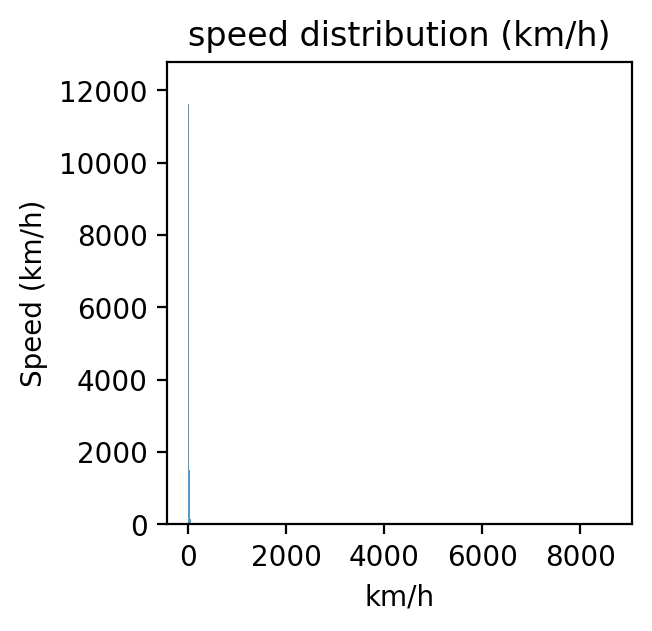

In [60]:
_, ax = plt.subplots(1, 1, figsize=(3, 3), dpi=200)

sns.histplot(X_train["km/h"], ax = ax)

ax.set_title("speed distribution (km/h)")

ax.set_ylabel("Speed (km/h)")

plt.show()

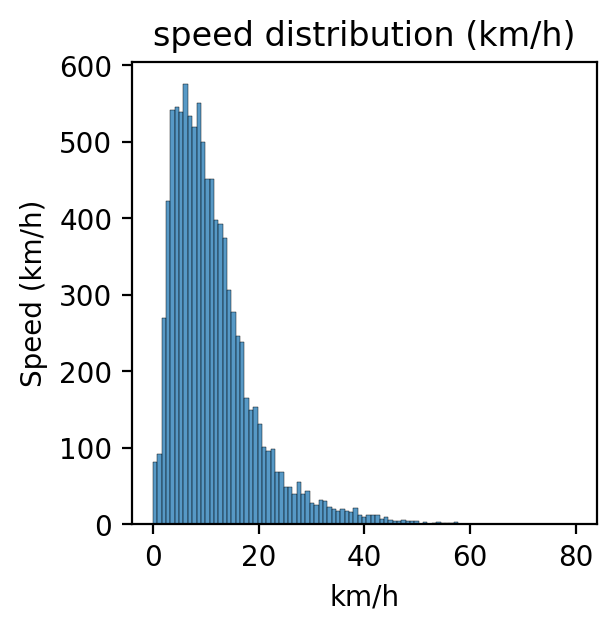

In [61]:
_, ax = plt.subplots(1, 1, figsize=(3, 3), dpi=200)

sns.histplot(X_train["km/h"].sample(10000), ax = ax)

ax.set_title("speed distribution (km/h)")

ax.set_ylabel("Speed (km/h)")

plt.show()

Как можно видеть по гистограмме, для некоторых объектов у нас получились очень больше значения скоростей. Нарисуйте гистограмму по объектам, для которых значение скорости получилось разумным (например, можно не включать рассмотрение объекты, где скорость больше некоторой квантили):

Оставлю значения меньше квантиля 0.995 и больше 0.0075 (выбрал значения так, чтобы график начал выглядеть адекватно)

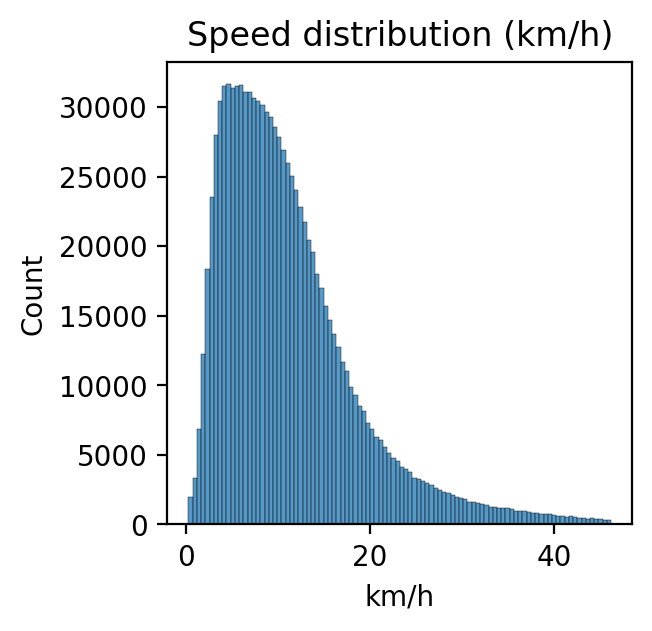

In [62]:
_, ax = plt.subplots(1, 1, figsize=(3, 3), dpi=200)

sns.histplot(X_train["km/h"][(X_train["km/h"] < X_train["km/h"].quantile(0.995)) & (X_train["km/h"] > X_train["km/h"].quantile(0.0075))], ax=ax, bins=100)

ax.set_title("Speed distribution (km/h)")

ax.set_ylabel("Count")

plt.show()

Для каждой пары (день недели, час суток) посчитайте медиану скоростей. Нарисуйте Heatmap-график, где по осям будут дни недели и часы, а в качестве значения функции - медиана скорости

In [63]:
mid_speed_to_day_and_hour = X_train.groupby(by=["dayofweek","hour" ])["km/h"].median().reset_index()
mid_speed_to_day_and_hour

<ipython-input-63-7e2194a326ec>:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mid_speed_to_day_and_hour = X_train.groupby(by=["dayofweek","hour" ])["km/h"].median().reset_index()


,dayofweek,hour,km/h
0,0,0,15.956458
1,0,1,15.677426
2,0,2,15.983776
3,0,3,16.412164
4,0,4,19.671345
...,...,...,...
163,6,19,10.904091
164,6,20,11.859908
165,6,21,12.525934
166,6,22,13.606358


<ipython-input-64-5de9c0fc77ea>:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  sns.heatmap(pd.pivot_table(data=mid_speed_to_day_and_hour, values="km/h", index="dayofweek", columns="hour"), ax=ax, cmap="coolwarm", annot=True, fmt=".1f")


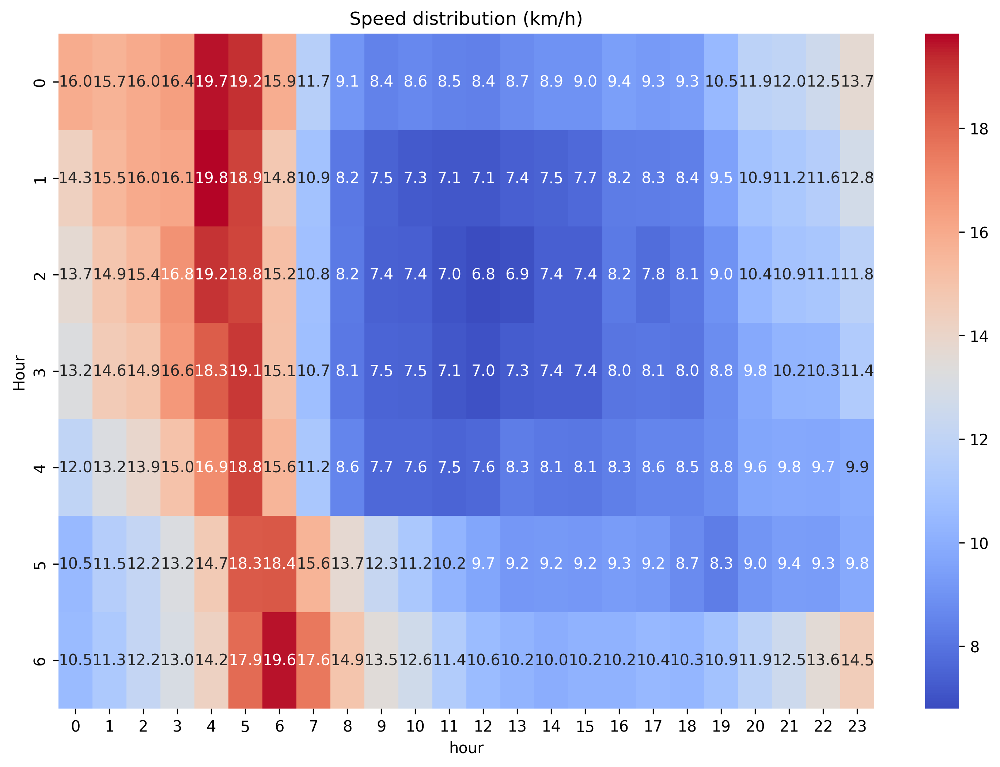

In [64]:
_, ax = plt.subplots(1, 1, figsize=(12, 8), dpi=300)

sns.heatmap(pd.pivot_table(data=mid_speed_to_day_and_hour, values="km/h", index="dayofweek", columns="hour"), ax=ax, cmap="coolwarm", annot=True, fmt=".1f")

ax.set_title("Speed distribution (km/h)")

ax.set_ylabel("Day of week")
ax.set_ylabel("Hour")

plt.show()

Не забудьте удалить колонку со значением скорости из данных!

**Вопрос**: Почему значение скорости нельзя использовать во время обучения?

Потому что для получения скорости мы использовали таргет, а для новых значений мы получить его не сможем. Таргет "протекает" во время обучения

In [65]:
X_train = X_train.drop(columns=["km/h"])
X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear,is_anomaly,haversine,log_haversine
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,114,False,43.019784,3.784639
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,77,False,2242.181301,7.715650
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,150,False,1893.667225,7.546798
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,49,False,1938.537941,7.570205
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,164,False,1853.193529,7.525205
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9,146,False,417.274631,6.036138
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10,165,False,2698.314844,7.900753
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8,132,False,499.254356,6.215117
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9,179,False,16887.185066,9.734370


**Вопрос**: Посмотрите внимательно на график и скажите, в какие моменты времени скорость минимальна; максимальна.

Создайте признаки "поездка совершается в период пробок" и "поездка совершается в период свободных дорог" (естественно, они не должен зависеть от скорости!):

In [66]:
X_train["is_jam"] = (
    ((X_train["dayofweek"].astype(int) <= int(4)) & (X_train["hour"].astype(int) >= int(8)) & (X_train["hour"].astype(int) <= int(19)))
    | ((X_train["dayofweek"].astype(int) == int(5)) & (X_train["hour"].astype(int) >= int(13)) & (X_train["hour"].astype(int) <= int(22)))
) # Примерно до 9.5

X_train["is_free"] = (
    ((X_train["dayofweek"].astype(int) <= int(4)) & (X_train["hour"].astype(int) >= int(3)) & (X_train["hour"].astype(int) <= int(6)))
    | ((X_train["dayofweek"].astype(int) == int(5)) & (X_train["hour"].astype(int) >= int(5)) & (X_train["hour"].astype(int) <= int(7)))
) # Примерно больше 16

X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear,is_anomaly,haversine,log_haversine,is_jam,is_free
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,114,False,43.019784,3.784639,False,False
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,77,False,2242.181301,7.715650,True,False
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,150,False,1893.667225,7.546798,False,False
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,49,False,1938.537941,7.570205,True,False
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,164,False,1853.193529,7.525205,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9,146,False,417.274631,6.036138,True,False
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10,165,False,2698.314844,7.900753,True,False
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8,132,False,499.254356,6.215117,True,False
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9,179,False,16887.185066,9.734370,True,False


In [67]:
X_test["is_jam"] = (
    ((X_test["dayofweek"].astype(int) <= int(4)) & (X_test["hour"].astype(int) >= int(8)) & (X_test["hour"].astype(int) <= int(19)))
    | ((X_test["dayofweek"].astype(int) == int(5)) & (X_test["hour"].astype(int) >= int(13)) & (X_test["hour"].astype(int) <= int(22)))
) # Примерно до 9.5

X_test["is_free"] = (
    ((X_test["dayofweek"].astype(int) <= int(4)) & (X_test["hour"].astype(int) >= int(3)) & (X_test["hour"].astype(int) <= int(6)))
    | ((X_test["dayofweek"].astype(int) == int(5)) & (X_test["hour"].astype(int) >= int(5)) & (X_test["hour"].astype(int) <= int(7)))
) # Примерно больше 16

X_test

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,dayofyear,is_anomaly,haversine,log_haversine,is_jam,is_free
311223,id1351089,2,2016-06-01 01:36:53,2,-73.975380,40.752270,-73.877319,40.756359,N,6,2,1,153,False,10916.784549,9.298148,False,False
667378,id3510251,2,2016-04-12 14:22:45,1,-73.957504,40.780113,-73.969849,40.760597,N,4,1,14,103,False,1499.505237,7.313557,True,False
1082806,id3390512,1,2016-04-30 18:16:12,1,-73.987099,40.722649,-73.966644,40.760147,N,4,5,18,121,False,2551.903556,7.844987,True,False
669682,id1466481,1,2016-05-30 05:11:53,1,-73.957420,40.711552,-73.974342,40.696213,N,5,0,5,151,True,1941.892031,7.571933,False,True
1146721,id2160798,1,2016-05-11 16:51:22,2,-73.991936,40.731087,-74.000282,40.720634,N,5,2,16,132,False,982.953783,6.891579,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1293900,id1488222,2,2016-02-17 09:31:29,1,-73.983948,40.743702,-73.991104,40.733322,N,2,2,9,48,False,858.039697,6.755815,True,False
1107585,id3422868,1,2016-05-25 21:09:41,1,-74.009308,40.716064,-74.016342,40.709995,N,5,2,21,146,False,804.860755,6.691911,False,False
1339778,id0025800,1,2016-03-04 13:53:57,1,-73.982262,40.746223,-73.776718,40.644764,N,3,4,13,64,False,23094.895705,10.047410,True,False
262828,id0609036,1,2016-01-02 13:21:01,2,-73.971428,40.755226,-73.789970,40.646999,N,1,5,13,2,False,20474.822811,9.927000,True,False


**Задание 8 (0.25 балла)**. Для каждого из замеченных вами выше 2-3 пунктов добавьте в выборку по два признака:
- началась ли поездка в этом пункте
- закончилась ли поездка в этом пункте

Как вы думаете, почему эти признаки могут быть полезны?

В качестве этих точек укажу два аэропорта и район манхэттон.
Аэропорты будут оплезны тем, что они далеко и время будет большое
Манхэттен наоборот находиться в центре, но пробки будут сильно влиять на него

P.S. Увидел что внизу манхеттен разделяется на части, так что выделять прямоугольник сейчас нет смысла. Ограничусь двумя аэропортами

JFK - Кэннеди
LGA - Ла-гвардия

Я взял точки в google maps

JFK:
- север - **40.668127**, -73.794013
- юг - **40.620195**, -73.780452
- запад - 40.661096, **-73.828002**
- восток - 40.638694, **-73.734618**

LGA:
- север - **40.783215**, -73.875069
- юг - **40.767348**, -73.874177
- запад - 40.773570, **-73.888761**
- восток - 40.767156, **-73.861058**
    

In [68]:
# JFK

X_train["is_pickup_JFK"] = (
    (X_train["pickup_latitude"] < 40.668127)
    & (X_train["pickup_latitude"] > 40.620195)
    & (X_train["pickup_longitude"] > -73.828002)
    & (X_train["pickup_longitude"] < -73.734618)
)

X_train["is_dropoff_JFK"] = (
    (X_train["dropoff_latitude"] < 40.668127)
    & (X_train["dropoff_latitude"] > 40.620195)
    & (X_train["dropoff_longitude"] > -73.828002)
    & (X_train["dropoff_longitude"] < -73.734618)
)

X_test["is_pickup_JFK"] = (
    (X_test["pickup_latitude"] < 40.668127)
    & (X_test["pickup_latitude"] > 40.620195)
    & (X_test["pickup_longitude"] > -73.828002)
    & (X_test["pickup_longitude"] < -73.734618)
)

X_test["is_dropoff_JFK"] = (
    (X_test["dropoff_latitude"] < 40.668127)
    & (X_test["dropoff_latitude"] > 40.620195)
    & (X_test["dropoff_longitude"] > -73.828002)
    & (X_test["dropoff_longitude"] < -73.734618)
)

In [69]:
# LGA

X_train["is_pickup_LGA"] = (
    (X_train["pickup_latitude"] < 40.783215)
    & (X_train["pickup_latitude"] > 40.767348)
    & (X_train["pickup_longitude"] > -73.888761)
    & (X_train["pickup_longitude"] < -73.861058)
)

X_train["is_dropoff_LGA"] = (
    (X_train["dropoff_latitude"] < 40.783215)
    & (X_train["dropoff_latitude"] > 40.767348)
    & (X_train["dropoff_longitude"] > -73.888761)
    & (X_train["dropoff_longitude"] < -73.861058)
)

X_test["is_pickup_LGA"] = (
    (X_test["pickup_latitude"] < 40.783215)
    & (X_test["pickup_latitude"] > 40.767348)
    & (X_test["pickup_longitude"] > -73.888761)
    & (X_test["pickup_longitude"] < -73.861058)
)

X_test["is_dropoff_LGA"] = (
    (X_test["dropoff_latitude"] < 40.783215)
    & (X_test["dropoff_latitude"] > 40.767348)
    & (X_test["dropoff_longitude"] > -73.888761)
    & (X_test["dropoff_longitude"] < -73.861058)
)


In [70]:
X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,...,dayofyear,is_anomaly,haversine,log_haversine,is_jam,is_free,is_pickup_JFK,is_dropoff_JFK,is_pickup_LGA,is_dropoff_LGA
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,...,114,False,43.019784,3.784639,False,False,False,False,False,False
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,...,77,False,2242.181301,7.715650,True,False,False,False,False,False
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,...,150,False,1893.667225,7.546798,False,False,False,False,False,False
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,...,49,False,1938.537941,7.570205,True,False,False,False,False,False
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,...,164,False,1853.193529,7.525205,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,...,146,False,417.274631,6.036138,True,False,False,False,False,False
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,...,165,False,2698.314844,7.900753,True,False,False,False,False,False
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,...,132,False,499.254356,6.215117,True,False,False,False,False,False
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,...,179,False,16887.185066,9.734370,True,False,False,False,True,False


In [71]:
print(X_train["is_pickup_JFK"].sum(), X_train["is_dropoff_JFK"].sum())
print(X_test["is_pickup_JFK"].sum(), X_test["is_dropoff_JFK"].sum())

22534 9497
9636 4067


In [72]:
X_train[(X_train["is_pickup_JFK"] | X_train["is_pickup_LGA"])]

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,...,dayofyear,is_anomaly,haversine,log_haversine,is_jam,is_free,is_pickup_JFK,is_dropoff_JFK,is_pickup_LGA,is_dropoff_LGA
364419,id2084218,1,2016-05-31 20:10:20,1,-73.863205,40.769875,-73.974319,40.748409,N,5,...,152,False,12386.906320,9.424476,False,False,False,False,True,False
170570,id1034647,1,2016-05-16 09:54:26,1,-73.776825,40.645164,-73.961937,40.776489,N,5,...,137,False,21003.016179,9.952469,True,False,True,False,False,False
1205814,id1253633,2,2016-04-10 21:19:36,1,-73.863350,40.770039,-73.921921,40.705952,N,4,...,101,False,6813.879313,8.826864,False,False,False,False,True,False
201241,id0156202,2,2016-01-25 18:30:29,2,-73.781860,40.644703,-74.015739,40.715042,N,1,...,25,True,26125.703056,10.170713,True,False,True,False,False,False
820446,id2480817,1,2016-01-22 14:44:04,2,-73.789787,40.643623,-74.001732,40.726021,N,1,...,22,False,23730.348018,10.074552,True,False,True,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
291223,id2989176,2,2016-04-26 23:23:08,2,-73.783409,40.648628,-73.984901,40.715420,N,4,...,117,False,22524.769313,10.022415,False,False,True,False,False,False
870945,id3160608,2,2016-01-02 22:28:02,1,-73.862770,40.769032,-73.957512,40.728851,N,1,...,2,False,10619.211990,9.270514,True,False,False,False,True,False
218060,id2479266,2,2016-01-25 13:01:18,1,-73.776756,40.645119,-73.978836,40.761627,N,1,...,25,True,22781.882205,10.033765,True,False,True,False,False,False
88831,id3207739,2,2016-06-05 23:31:09,2,-73.776718,40.645302,-73.986717,40.761349,N,6,...,157,False,23650.483444,10.071181,False,False,True,False,False,False


In [73]:
 # Проверю на карте


sample = X_train[(X_train["is_pickup_JFK"] | X_train["is_pickup_LGA"])].sample(1000)
your_lat_values = sample["pickup_latitude"]
your_lon_values = sample["pickup_longitude"]

show_circles_on_map(your_lat_values, your_lon_values, color="midnightblue")
# Всё работает

Для каждого из созданных признаков нарисуйте "ящик с усами" (aka boxplot) распределения логарифма времени поездки

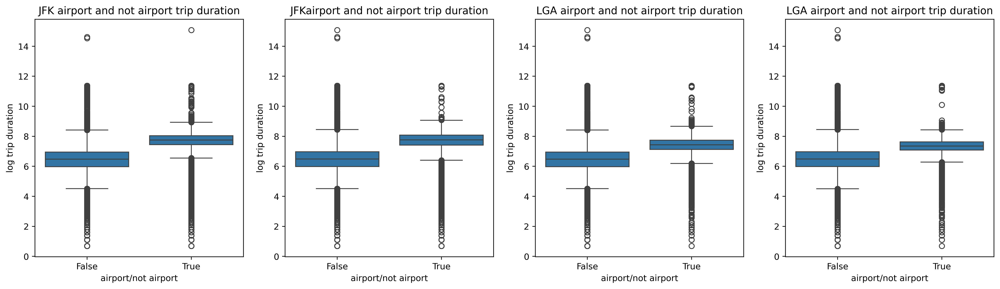

In [74]:
_, ax = plt.subplots(1, 4, figsize=(20, 5), dpi=400)

sns.boxplot(x=X_train["is_pickup_JFK"] ,y=y_train, ax=ax[0])
sns.boxplot(x=X_train["is_dropoff_JFK"] ,y=y_train, ax=ax[1])
sns.boxplot(x=X_train["is_pickup_LGA"] ,y=y_train, ax=ax[2])
sns.boxplot(x=X_train["is_dropoff_LGA"] ,y=y_train, ax=ax[3])

ax[0].set_title("JFK airport and not airport trip duration")
ax[0].set_xlabel("airport/not airport")
ax[0].set_ylabel("log trip duration")

ax[1].set_title("JFKairport and not airport trip duration")
ax[1].set_xlabel("airport/not airport")
ax[1].set_ylabel("log trip duration")

ax[2].set_title("LGA airport and not airport trip duration")
ax[2].set_xlabel("airport/not airport")
ax[2].set_ylabel("log trip duration")

ax[3].set_title("LGA airport and not airport trip duration")
ax[3].set_xlabel("airport/not airport")
ax[3].set_ylabel("log trip duration")

plt.show()

**Вопрос**: судя по графикам, как вы думаете, хорошими ли получились эти признаки?

**Ответ**: Да, признаки получились прекрасным, по ним можно легко разделить время в пути (из аэропорта всегда дольше). Я большой молодец.

<img src="https://www.dropbox.com/s/xson9nukz5hba7c/map.png?raw=1" align="right" width="20%" style="margin-left: 20px; margin-bottom: 20px">

**Задание 9 (1 балл)**. Сейчас мы почти что не используем сами значения координат. На это есть несколько причин: по отдельности рассматривать широту и долготу не имеет особого смысла, стоит рассматривать их вместе. Во-вторых, понятно, что зависимость между нашим таргетом и координатами не линейная. Чтобы как-то использовать координаты, можно прибегнуть к следующему трюку: обрамим область с наибольшим количеством поездок прямоугольником (как на рисунке). Разобьем этот прямоугольник на ячейки. Каждой точке сопоставим номер ее ячейки, а тем точкам, что не попали ни в одну из ячеек, сопоставим значение -1.

Напишите трансформер, который сначала разбивает показанную на рисунке область на ячейки, а затем создает два признака: номер ячейки, в которой началась поездка, и номер ячейки, в которой закончилась поездка. Количество строк и столбцов выберите самостоятельно.

Обратите внимание, что все вычисления должны быть векторизованными, трансформер не должен модифицировать передаваемую ему выборку inplace, а все необходимые статистики (если они вдруг нужны) нужно считать только по обучающей выборке в методе `fit`:

In [75]:
X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,...,dayofyear,is_anomaly,haversine,log_haversine,is_jam,is_free,is_pickup_JFK,is_dropoff_JFK,is_pickup_LGA,is_dropoff_LGA
1428403,id0932914,2,2016-04-23 02:48:55,5,-73.978020,40.764832,-73.977821,40.763630,N,4,...,114,False,43.019784,3.784639,False,False,False,False,False,False
55209,id2262221,2,2016-03-17 14:06:58,1,-73.968948,40.761173,-73.988464,40.743122,N,3,...,77,False,2242.181301,7.715650,True,False,False,False,False,False
884486,id2346367,2,2016-05-29 10:17:11,1,-73.982498,40.765347,-73.999474,40.761353,N,5,...,150,False,1893.667225,7.546798,False,False,False,False,False,False
321414,id3263388,2,2016-02-18 10:52:09,2,-73.991211,40.731628,-74.007294,40.707401,N,2,...,49,False,1938.537941,7.570205,True,False,False,False,False,False
1341812,id3125940,2,2016-06-12 14:40:08,1,-73.982033,40.742386,-73.966270,40.761787,N,6,...,164,False,1853.193529,7.525205,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,id2015006,2,2016-05-25 09:43:56,5,-74.015259,40.709389,-74.011528,40.708069,N,5,...,146,False,417.274631,6.036138,True,False,False,False,False,False
233024,id0780028,2,2016-06-13 10:20:25,1,-73.994171,40.751026,-73.970390,40.768032,N,6,...,165,False,2698.314844,7.900753,True,False,False,False,False,False
328072,id3960122,2,2016-05-11 08:23:39,1,-73.987450,40.750000,-73.982971,40.750870,N,5,...,132,False,499.254356,6.215117,True,False,False,False,False,False
1190701,id3258973,1,2016-06-27 09:03:25,1,-73.865097,40.770668,-74.015816,40.708389,N,6,...,179,False,16887.185066,9.734370,True,False,False,False,True,False


Сначала я в качестве параметров конструктора использовал в том числе границы прямоугольника, но раз уж нужно что-то обучать на трейне, буду подавать в конструктур нужный границы квантия, по которым прямоугольник будет сам подбираться по тренировочной выборке. Подбирать буду по началу поездки, так как почти наверняка эти два прямоугольника будут одинаковые. Итоговые столбец должен быть строкой вида row_col (где row и col это номер ячейки по горизонтали и вертикали соответственно). Если элемент лежит вне строки, то значение будет -1. После этого строку нужно будет кодировать с помощью One-hot

In [76]:
from sklearn.base import BaseEstimator, TransformerMixin


# TransformerMixin implements fit_transform for you,
# applying your fit and transform consistently

class MapGridTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, height: int,
                 width: int,
                 quantile_top: float = 0.9,
                 quantile_bot: float = 0.1,
                 quantile_left: float = 0.1,
                 quantile_right: float = 0.9,
                 pickup_latitude_name: str = "pickup_latitude",
                 pickup_longitude_name: str = "pickup_longitude",
                 dropoff_latitude_name: str = "dropoff_latitude",
                 dropoff_longitude_name: str = "dropoff_longitude"
                 ) -> None:
        self.height = height + 1
        self.width = width + 1
        self.quantile_top = quantile_top
        self.quantile_bot = quantile_bot
        self.quantile_left = quantile_left
        self.quantile_right = quantile_right
        self.pickup_latitude_name = pickup_latitude_name
        self.pickup_longitude_name = pickup_longitude_name
        self.dropoff_latitude_name = dropoff_latitude_name
        self.dropoff_longitude_name = dropoff_longitude_name

        self.top_border = None
        self.bot_border = None
        self.left_border = None
        self.right_border = None




    def show_map(self, color: str = "blue"):
        # Визуализирую границы прямоугольника
        if not self.top_border or not self.bot_border or not self.left_border or not self.right_border:
            return None
        location = (np.mean(self.latitude_mean), np.mean(self.longitude_mean))
        m = folium.Map(location=location)

        folium.PolyLine(
            locations=[[ self.top_border, self.left_border],[self.bot_border, self.left_border]],
            color=color,
            weight=2
        ).add_to(m)

        folium.PolyLine(
            locations=[[ self.bot_border, self.left_border],[self.bot_border, self.right_border]],
            color=color,
            weight=2
        ).add_to(m)

        folium.PolyLine(
            locations=[[ self.top_border, self.right_border],[self.bot_border, self.right_border]],
            color=color,
            weight=1
        ).add_to(m)

        folium.PolyLine(
            locations=[[ self.top_border, self.left_border],[self.top_border, self.right_border]],
            color=color,
            weight=1
        ).add_to(m)

        # Тут цикл, да, но это вообще не обязательное задание! Очень уж хотелось посмотреть...
        for line in np.linspace(self.bot_border, self.top_border, num=self.height):
            folium.PolyLine(
                locations=[[ line, self.left_border],[line, self.right_border]],
                color=color,
                weight=1

            ).add_to(m)
        for col in np.linspace(self.left_border, self.right_border, num=self.width):
            folium.PolyLine(
                locations=[[ self.bot_border, col],[self.top_border,col]],
                color=color,
                weight=1
            ).add_to(m)
        return m


    def fit(self, X=None):
        if X is None or y is None:
            return self

        self.top_border = np.quantile(X[[self.pickup_latitude_name]], self.quantile_top)
        self.bot_border = np.quantile(X[[self.pickup_latitude_name]], self.quantile_bot)
        self.left_border = np.quantile(X[[self.pickup_longitude_name]], self.quantile_left)
        self.right_border = np.quantile(X[[self.pickup_longitude_name]], self.quantile_right)

        self.latitude_mean = np.mean(X[[self.pickup_latitude_name]])
        self.longitude_mean = np.mean(X[[self.pickup_longitude_name]])

        return self

    def transform(self, X):

        def find_cell(row, col):
            cell_row = np.searchsorted(np.linspace(self.bot_border, self.top_border, num=self.height), row)
            cell_col = np.searchsorted(np.linspace(self.right_border, self.left_border, num=self.width), col)
            if cell_row == 0 or cell_row == self.height or cell_col == 0 or cell_col == self.width:
                return "-1"
            else:
                return str(cell_row) + "_" + str(cell_col)

        find_cell_vectorize = np.vectorize(find_cell)

        pickup_cell = find_cell_vectorize(X[[self.pickup_latitude_name]], X[[self.pickup_longitude_name]])
        dropoff_cell = find_cell_vectorize(X[[self.dropoff_latitude_name]], X[[self.dropoff_longitude_name]])

        return pickup_cell, dropoff_cell

In [77]:
transformer = MapGridTransformer(4, 3, 0.99, 0.03, 0.95, 0.01) # Выбрал так, чтобы манхэттон попадал полностью. Количество клеток как на картинке выше

transformer.fit(X_train)

transformer.show_map()

In [78]:
X_train["pickup_cell"], X_train["dropoff_cell"]  = transformer.transform(X_train)

In [79]:
X_test["pickup_cell"], X_test["dropoff_cell"]  = transformer.transform(X_test)

In [80]:
X_train["pickup_cell"] = X_train["pickup_cell"].astype("category")
X_train["dropoff_cell"] = X_train["dropoff_cell"].astype("category")
X_train["is_jam"] = X_train["is_jam"].astype("category")
X_train["is_free"] = X_train["is_free"].astype("category")
X_train["is_pickup_JFK"] = X_train["is_pickup_JFK"].astype("category")
X_train["is_dropoff_JFK"] = X_train["is_dropoff_JFK"].astype("category")
X_train["is_pickup_LGA"] = X_train["is_pickup_LGA"].astype("category")
X_train["is_dropoff_LGA"] = X_train["is_dropoff_LGA"].astype("category")

X_test["pickup_cell"] = X_test["pickup_cell"].astype("category")
X_test["dropoff_cell"] = X_test["dropoff_cell"].astype("category")
X_test["is_jam"] = X_train["is_jam"].astype("category")
X_test["is_free"] = X_train["is_free"].astype("category")
X_test["is_pickup_JFK"] = X_train["is_pickup_JFK"].astype("category")
X_test["is_dropoff_JFK"] = X_train["is_dropoff_JFK"].astype("category")
X_test["is_pickup_LGA"] = X_train["is_pickup_LGA"].astype("category")
X_test["is_dropoff_LGA"] = X_train["is_dropoff_LGA"].astype("category")


In [81]:
# Дропну уже эти даты и id)
if "id" in X_train.columns:
    X_train = X_train.drop(columns=["id", "pickup_datetime"])

**Задание 10 (0.25 балла)**. Обучите `Ridge`-регрессию со стандартными параметрами на признаках, которые мы выделили к текущему моменту. Категориальные признаки закодируйте через one-hot-кодирование, числовые признаки отмасштабируйте.

In [82]:
X_train

,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,...,haversine,log_haversine,is_jam,is_free,is_pickup_JFK,is_dropoff_JFK,is_pickup_LGA,is_dropoff_LGA,pickup_cell,dropoff_cell
1428403,2,5,-73.978020,40.764832,-73.977821,40.763630,N,4,5,2,...,43.019784,3.784639,False,False,False,False,False,False,3_1,3_1
55209,2,1,-73.968948,40.761173,-73.988464,40.743122,N,3,3,14,...,2242.181301,7.715650,True,False,False,False,False,False,3_2,2_1
884486,2,1,-73.982498,40.765347,-73.999474,40.761353,N,5,6,10,...,1893.667225,7.546798,False,False,False,False,False,False,3_1,3_1
321414,2,2,-73.991211,40.731628,-74.007294,40.707401,N,2,3,10,...,1938.537941,7.570205,True,False,False,False,False,False,2_1,1_1
1341812,2,1,-73.982033,40.742386,-73.966270,40.761787,N,6,6,14,...,1853.193529,7.525205,False,False,False,False,False,False,2_1,3_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,2,5,-74.015259,40.709389,-74.011528,40.708069,N,5,2,9,...,417.274631,6.036138,True,False,False,False,False,False,-1,1_1
233024,2,1,-73.994171,40.751026,-73.970390,40.768032,N,6,0,10,...,2698.314844,7.900753,True,False,False,False,False,False,3_1,3_2
328072,2,1,-73.987450,40.750000,-73.982971,40.750870,N,5,2,8,...,499.254356,6.215117,True,False,False,False,False,False,3_1,3_1
1190701,1,1,-73.865097,40.770668,-74.015816,40.708389,N,6,0,9,...,16887.185066,9.734370,True,False,False,False,True,False,-1,-1


In [83]:
X_train.dtypes

,0
vendor_id,category
passenger_count,int64
pickup_longitude,float64
pickup_latitude,float64
dropoff_longitude,float64
dropoff_latitude,float64
store_and_fwd_flag,category
month,category
dayofweek,category
hour,category


Что-то у меня ноутбук падать начал))

In [84]:
gc.collect()

18186

In [85]:
%whos DataFrame

Variable                    Type         Data/Info
--------------------------------------------------
X                           DataFrame                    id  vendo<...>458644 rows x 12 columns]
X_test                      DataFrame                    id vendor<...>437594 rows x 24 columns]
X_train                     DataFrame            vendor_id  passen<...>021050 rows x 22 columns]
hour_hue_month_to_freq      DataFrame         hour  month     id\n<...>n\n[144 rows x 3 columns]
hour_hue_week_day_to_freq   DataFrame         hour  dayofweek     <...>n\n[168 rows x 3 columns]
mid_speed_to_day_and_hour   DataFrame        dayofweek hour       <...>n\n[168 rows x 3 columns]
sample                      DataFrame                    id vendor<...>n[1000 rows x 22 columns]
train                       DataFrame                    id  vendo<...>458644 rows x 14 columns]


In [86]:
del X
del sample
del train
del hour_hue_month_to_freq
del hour_hue_week_day_to_freq
del mid_speed_to_day_and_hour


In [87]:
gc.collect()

2924050

In [88]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer

# Удалю ещё 3 столбца, чтобы протестировать их в следующем задании

category_columns = X_train.drop(columns=["passenger_count", "store_and_fwd_flag", "vendor_id"]).select_dtypes(include=['category']).columns
numerical_columns = X_train.drop(columns=["passenger_count", "store_and_fwd_flag", "vendor_id"]).select_dtypes(include=['float64', 'int64']).columns

# Трансформер, чтобы обрабатывать только категориальные признаки
ohe_preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown="ignore"), category_columns), # sparse_output=False
        # Дропаю первый, чтобы не было мультиколлинеарности
        # ignore - игнорировать неизвестные категории (все столбцы False)
        ('num', StandardScaler(), numerical_columns)
    ],
    remainder='passthrough'
)

X_train_encoded = ohe_preprocessor.fit_transform(X_train.drop(columns=["passenger_count", "store_and_fwd_flag", "vendor_id"]))
X_test_encoded = ohe_preprocessor.transform(X_test.drop(columns=["passenger_count", "store_and_fwd_flag", "vendor_id"]))

column_names = list(map(lambda name: name.split("__")[1], ohe_preprocessor.get_feature_names_out()))

X_train_encoded = pd.DataFrame.sparse.from_spmatrix(X_train_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])
X_test_encoded = pd.DataFrame.sparse.from_spmatrix(X_test_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])

display(X_train_encoded.sample(5))
display(X_test_encoded.sample(5))

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [5, 6, 7, 8, 9, 10] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,dropoff_cell_2_2,dropoff_cell_2_3,dropoff_cell_3_1,dropoff_cell_3_2,dropoff_cell_3_3,dropoff_cell_4_1,dropoff_cell_4_2,dropoff_cell_4_3,haversine,log_haversine
836184,0,0,0,1.0,0,0,0,0,1.0,0,...,0,0,0,0,0,0,0,0,-0.244083,0.109991
278276,0,0,0,0,0,1.0,0,0,0,0,...,0,0,0,0,0,0,0,0,2.911237,2.01556
664111,0,1.0,0,0,0,0,0,1.0,0,0,...,0,0,0,1.0,0,0,0,0,-0.287384,0.008904
624684,0,0,0,1.0,0,0,0,0,1.0,0,...,0,0,1.0,0,0,0,0,0,-0.413059,-0.376712
167121,0,0,0,0,0,0,0,0,0,0,...,0,0,1.0,0,0,0,0,0,4.371493,2.314059


,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,dropoff_cell_2_2,dropoff_cell_2_3,dropoff_cell_3_1,dropoff_cell_3_2,dropoff_cell_3_3,dropoff_cell_4_1,dropoff_cell_4_2,dropoff_cell_4_3,haversine,log_haversine
382768,0,0,1.0,0,0,1.0,0,0,0,0,...,0,0,0,0,0,0,0,0,-0.474395,-0.653718
207661,1.0,0,0,0,0,1.0,0,0,0,0,...,0,0,0,0,0,0,1.0,0,-0.189539,0.222535
166927,0,0,0,0,1.0,0,0,0,1.0,0,...,0,0,0,1.0,0,0,0,0,-0.183672,0.233814
353005,0,0,0,0,0,0,0,0,0,1.0,...,0,0,1.0,0,0,0,0,0,-0.448308,-0.524948
412370,0,0,0,0,1.0,0,0,0,1.0,0,...,0,0,1.0,0,0,0,0,0,-0.390686,-0.294284


In [89]:
X_train_encoded

,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,dropoff_cell_2_2,dropoff_cell_2_3,dropoff_cell_3_1,dropoff_cell_3_2,dropoff_cell_3_3,dropoff_cell_4_1,dropoff_cell_4_2,dropoff_cell_4_3,haversine,log_haversine
0,0,0,1.0,0,0,0,0,0,0,1.0,...,0,0,1.0,0,0,0,0,0,-0.627388,-3.093157
1,0,1.0,0,0,0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,0,-0.14127,0.311231
2,0,0,0,1.0,0,0,0,0,0,0,...,0,0,1.0,0,0,0,0,0,-0.218308,0.165
3,1.0,0,0,0,0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,0,-0.20839,0.185271
4,0,0,0,0,1.0,0,0,0,0,0,...,0,0,0,1.0,0,0,0,0,-0.227255,0.146299
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1021045,0,0,0,1.0,0,0,1.0,0,0,0,...,0,0,0,0,0,0,0,0,-0.54466,-1.143283
1021046,0,0,0,0,1.0,0,0,0,0,0,...,0,0,0,1.0,0,0,0,0,-0.040443,0.471537
1021047,0,0,0,1.0,0,0,1.0,0,0,0,...,0,0,1.0,0,0,0,0,0,-0.526539,-0.988281
1021048,0,0,0,0,1.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,3.09596,2.05951


In [90]:
from sklearn.linear_model import Ridge


ridge_regression = Ridge()

ridge_regression.fit(X=X_train_encoded, y=y_train)

train_pred = ridge_regression.predict(X_train_encoded)
test_pred = ridge_regression.predict(X_test_encoded)

In [91]:
# const: 0.7957592365411509

# Прошлое:
# Train rmsle: {0.7878834255331718}
# Test rmsle: {0.7860984591861254}
print("Train rmsle:", {rmsle(y_train, train_pred)})
print("Test rmsle:", {rmsle(y_test, test_pred)})
# Ещё лучше

Train rmsle: {0.5512830196529935}
Test rmsle: {0.5647519755311392}


In [92]:
del X_train_encoded
del X_test_encoded

gc.collect()

0

## Часть 3. Изучаем оставшиеся признаки (1 балл)

**Задание 11 (0.75 баллов)**. У нас осталось еще 3 признака, которые мы не исследовали: `vendor_id`, `passenger_count` и `store_and_fwd_flag`.

**Вопрос**: Подумайте, почему каждый из этих признаков может быть потенциально полезным.

C kaggle:
vendor_id - a code indicating the provider associated with the trip record

passenger_count - the number of passengers in the vehicle (driver entered value)

store_and_fwd_flag - This flag indicates whether the trip record was held in vehicle memory before sending to the vendor because the vehicle did not have a connection to the server - Y=store and forward; N=not a store and forward trip

**Ответ**: По id вендора возможно можно отличать более быстрых/аккуратных водителей друг от друга. По количеству пассажиров тоже можно понять скорость, если в машине много пассажиров, то, возможно, каждого придётся отвозить в своё место, да и машина становится тяжелее и проблем больше. Не очень понял смысл последнего пункта, но возможно из него можно извлечь информацию о постоянных клиентах, маршрут которых уже знаком водителю.

Посчитайте, сколько есть уникальных значений у каждого из этих признаков:

In [93]:
print(f"vendor_id unique values:", len(X_train['vendor_id'].unique()))
print(f"passenger_count unique values:", len(X_train['passenger_count'].unique()))
print(f"store_and_fwd_flag unique values:", len(X_train['store_and_fwd_flag'].unique()))

vendor_id unique values: 2
passenger_count unique values: 9
store_and_fwd_flag unique values: 2


Постройте "ящики с усами" распределений логарифма времени поездки в зависимости от значений каждого из признаков

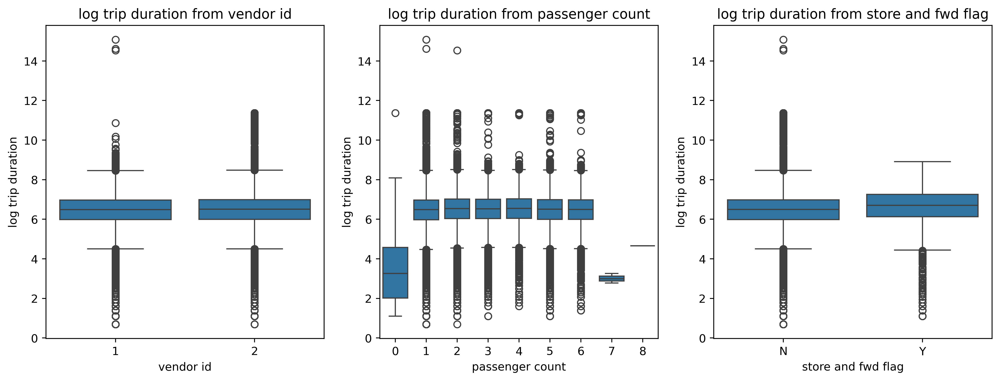

In [94]:
_, ax = plt.subplots(1, 3, figsize=(15, 5), dpi=400)

sns.boxplot(x=X_train["vendor_id"] ,y=y_train, ax=ax[0])
sns.boxplot(x=X_train["passenger_count"] ,y=y_train, ax=ax[1])
sns.boxplot(x=X_train["store_and_fwd_flag"] ,y=y_train, ax=ax[2])

ax[0].set_title("log trip duration from vendor id")
ax[0].set_xlabel("vendor id")
ax[0].set_ylabel("log trip duration")

ax[1].set_title("log trip duration from passenger count")
ax[1].set_xlabel("passenger count")
ax[1].set_ylabel("log trip duration")

ax[2].set_title("log trip duration from store and fwd flag")
ax[2].set_xlabel("store and fwd flag")
ax[2].set_ylabel("log trip duration")

plt.show()

Переведите признаки `vendor_id` и `store_and_fwd_flag` в значения $\{0;1\}$

In [95]:
# Не совсем понял зачем это делать, ведь признаки всё равно кодируются с помощью One-Hot, но ладно

X_train["vendor_id"] = X_train["vendor_id"].replace({1: 0, 2: 1})
X_train["store_and_fwd_flag"] = X_train["store_and_fwd_flag"].replace({'N': 0, 'Y': 1})

X_test["vendor_id"] = X_test["vendor_id"].replace({'1': 0, '2': 1})
X_test["store_and_fwd_flag"] = X_test["store_and_fwd_flag"].replace({'N': 0, 'Y': 1})

<ipython-input-95-c029fc5a3385>:3: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  X_train["vendor_id"] = X_train["vendor_id"].replace({1: 0, 2: 1})
<ipython-input-95-c029fc5a3385>:4: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X_train["store_and_fwd_flag"] = X_train["store_and_fwd_flag"].replace({'N': 0, 'Y': 1})
<ipython-input-95-c029fc5a3385>:4: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To chang

In [96]:
X_train

,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,dayofweek,hour,...,haversine,log_haversine,is_jam,is_free,is_pickup_JFK,is_dropoff_JFK,is_pickup_LGA,is_dropoff_LGA,pickup_cell,dropoff_cell
1428403,1,5,-73.978020,40.764832,-73.977821,40.763630,0,4,5,2,...,43.019784,3.784639,False,False,False,False,False,False,3_1,3_1
55209,1,1,-73.968948,40.761173,-73.988464,40.743122,0,3,3,14,...,2242.181301,7.715650,True,False,False,False,False,False,3_2,2_1
884486,1,1,-73.982498,40.765347,-73.999474,40.761353,0,5,6,10,...,1893.667225,7.546798,False,False,False,False,False,False,3_1,3_1
321414,1,2,-73.991211,40.731628,-74.007294,40.707401,0,2,3,10,...,1938.537941,7.570205,True,False,False,False,False,False,2_1,1_1
1341812,1,1,-73.982033,40.742386,-73.966270,40.761787,0,6,6,14,...,1853.193529,7.525205,False,False,False,False,False,False,2_1,3_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454033,1,5,-74.015259,40.709389,-74.011528,40.708069,0,5,2,9,...,417.274631,6.036138,True,False,False,False,False,False,-1,1_1
233024,1,1,-73.994171,40.751026,-73.970390,40.768032,0,6,0,10,...,2698.314844,7.900753,True,False,False,False,False,False,3_1,3_2
328072,1,1,-73.987450,40.750000,-73.982971,40.750870,0,5,2,8,...,499.254356,6.215117,True,False,False,False,False,False,3_1,3_1
1190701,0,1,-73.865097,40.770668,-74.015816,40.708389,0,6,0,9,...,16887.185066,9.734370,True,False,False,False,True,False,-1,-1


**Вопрос**: Основываясь на графиках выше, как вы думаете, будут ли эти признаки сильными?

**Ответ**: Нет, скорее даже бесполезными. По id вендора никак нельяз разделить длину поездки. По колличестку пассажиров уже лучше, но скорее всего за счёт того, что 0 и 7+ это выбросы, в которых время пути аномально низкое (возможно пассажиров просто не брали и поездка сразу заканчивась).
store_and_fwd_flag, как и id вендора, выглядит как бесполезный признак, но будто-бы по нему можно данные совсем немного разделить, но врядли это сильно поможет. Если чество, я бы их всех удалил ещё в начале...

**Задание 12 (0.25 баллов)**. Проверьте свои предположения, обучив модель в том числе и на этих трех признаках. Обучайте `Ridge`-регрессию со стандартными параметрами. Категориальные признаки закодируйте one-hot-кодированием, а численные отмасштабируйте.

In [97]:
gc.collect()

22267

In [98]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer

category_columns = X_train.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['category']).columns
numerical_columns = X_train.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['float64', 'int64']).columns

# Трансформер, чтобы обрабатывать только категориальные признаки
ohe_preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown="ignore"), category_columns), # sparse_output=False
        # Дропаю первый, чтобы не было мультиколлинеарности
        # ignore - игнорировать неизвестные категории (все столбцы False)
        ('num', StandardScaler(), numerical_columns)
    ],
    remainder='passthrough'
)

X_train_encoded = ohe_preprocessor.fit_transform(X_train)
X_test_encoded = ohe_preprocessor.transform(X_test)

column_names = list(map(lambda name: name.split("__")[1], ohe_preprocessor.get_feature_names_out()))

X_train_encoded = pd.DataFrame.sparse.from_spmatrix(X_train_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])
X_test_encoded = pd.DataFrame.sparse.from_spmatrix(X_test_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])

display(X_train_encoded.sample(5))
display(X_test_encoded.sample(5))

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 7, 8, 9, 10, 11, 12] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,vendor_id_1,store_and_fwd_flag_1,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,...,dropoff_cell_2_3,dropoff_cell_3_1,dropoff_cell_3_2,dropoff_cell_3_3,dropoff_cell_4_1,dropoff_cell_4_2,dropoff_cell_4_3,passenger_count,haversine,log_haversine
67386,0,0,0,1.0,0,0,0,1.0,0,0,...,0,1.0,0,0,0,0,0,-0.505722,0.300503,0.862961
461746,1.0,0,0,0,0,0,1.0,0,1.0,0,...,0,0,0,0,0,1.0,0,-0.505722,0.143809,0.704595
781662,0,0,0,0,0,1.0,0,0,0,0,...,0,0,0,0,0,0,0,-0.505722,-0.025789,0.49255
1002163,1.0,0,1.0,0,0,0,0,0,0,0,...,0,1.0,0,0,0,0,0,-0.505722,-0.28962,0.003347
144612,1.0,0,0,0,0,0,1.0,0,0,0,...,0,0,0,0,0,1.0,0,-0.505722,-0.402048,-0.335164


,vendor_id_1,store_and_fwd_flag_1,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,...,dropoff_cell_2_3,dropoff_cell_3_1,dropoff_cell_3_2,dropoff_cell_3_3,dropoff_cell_4_1,dropoff_cell_4_2,dropoff_cell_4_3,passenger_count,haversine,log_haversine
107042,1.0,0,1.0,0,0,0,0,0,0,1.0,...,0,0,0,0,0,0,0,-0.505722,-0.047896,0.460651
429332,1.0,0,0,0,0,0,1.0,0,0,1.0,...,0,0,0,0,0,0,0,-0.505722,-0.332521,-0.11077
270734,1.0,0,1.0,0,0,0,0,0,0,0,...,0,1.0,0,0,0,0,0,-0.505722,-0.426238,-0.429209
229845,0,0,0,0,0,0,0,1.0,0,0,...,0,1.0,0,0,0,0,0,-0.505722,-0.550558,-1.200367
128133,0,0,1.0,0,0,0,0,0,0,0,...,0,0,0,1.0,0,0,0,2.53628,0.326673,0.886802


In [99]:
from sklearn.linear_model import Ridge


ridge_regression = Ridge()

ridge_regression.fit(X=X_train_encoded, y=y_train)

train_pred = ridge_regression.predict(X_train_encoded)
test_pred = ridge_regression.predict(X_test_encoded)

In [100]:
# const: 0.7957592365411509

# Прошлое:
# Train rmsle: {0.5512830196529935}
# Test rmsle: {0.5647519755311392}

print("Train rmsle:", {rmsle(y_train, train_pred)})
print("Test rmsle:", {rmsle(y_test, test_pred)})
# Стало чуточку лучше, но ощутимого улучшения метрик не дали, так что удалю

Train rmsle: {0.5510813491383075}
Test rmsle: {0.5651426024751189}


In [101]:
if "passenger_count" in X_train.columns:
    X_train = X_train.drop(columns=["passenger_count", "store_and_fwd_flag", "vendor_id", "haversine"])
    X_test = X_test.drop(columns=["passenger_count", "store_and_fwd_flag", "vendor_id", "haversine"])

Если признаки не дали какого-то ощутимого улучшения метрики, их можно выбросить из данных.

## Часть 4. Улучшаем модель (3 балла)

**Задание 13 (1 балл)**. В наших данных есть нетипичные объекты (выбросы, или outliers): с аномально маленьким времени поездки, с очень большим пройденным расстоянием или очень большими остатками регрессии. В этом задании предлагается исключить такие объекты из обучающей выборки. Для этого нарисуйте гистограммы распределения упомянутых выше величин, выберите объекты, которые можно назвать выбросами, и очистите __обучающую выборку__ от них.

Отметим, что хотя эти объекты и выглядят как выбросы, в тестовой выборке тоже скорее всего будут объекты с такими же странными значениями целевой переменной и/или признаков. Поэтому, возможно, чистка обучающей выборки приведёт к ухудшению качества на тесте. Тем не менее, всё равно лучше удалять выбросы из обучения, чтобы модель получалась более разумной и интерпретируемой.

Вообще, наверное лучше использовать ящик с усами, но сделаю histplot по заданию

In [102]:
# Сохраню таргет в x, чтобы у него тоже изменился размер
X_train["target"] = y_train

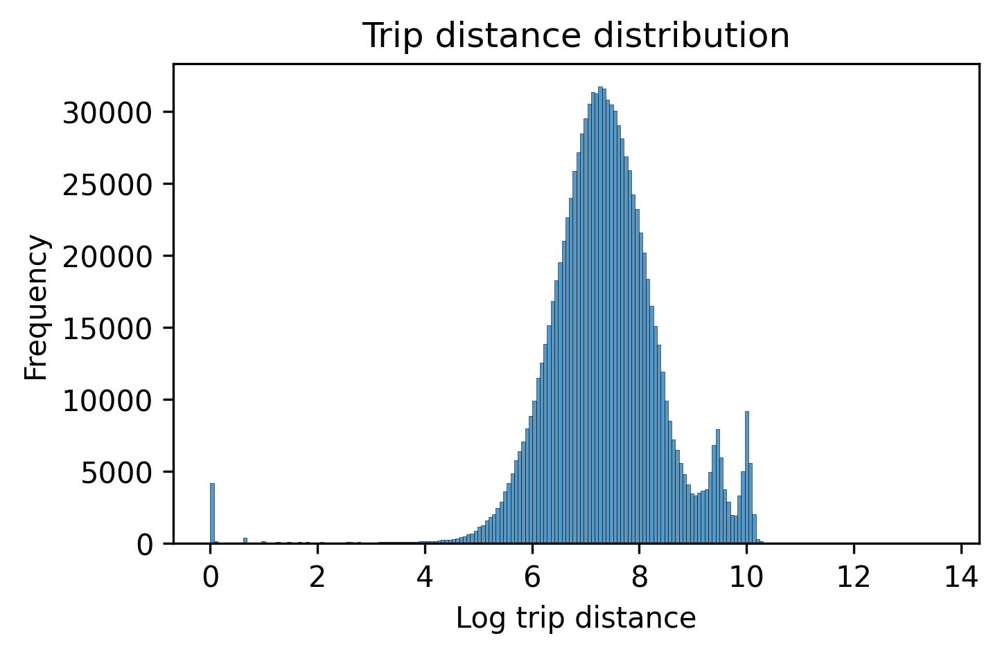

In [103]:
_, ax = plt.subplots(figsize=(5, 3), dpi=300)

plt.subplot(1, 1, 1)

sns.histplot(X_train["log_haversine"], bins=200)

plt.title("Trip distance distribution")

plt.ylabel("Frequency")
plt.xlabel("Log trip distance")


plt.show()

In [104]:
X_train = X_train[(X_train["log_haversine"] > 4) & (X_train["log_haversine"] < 10.25)]

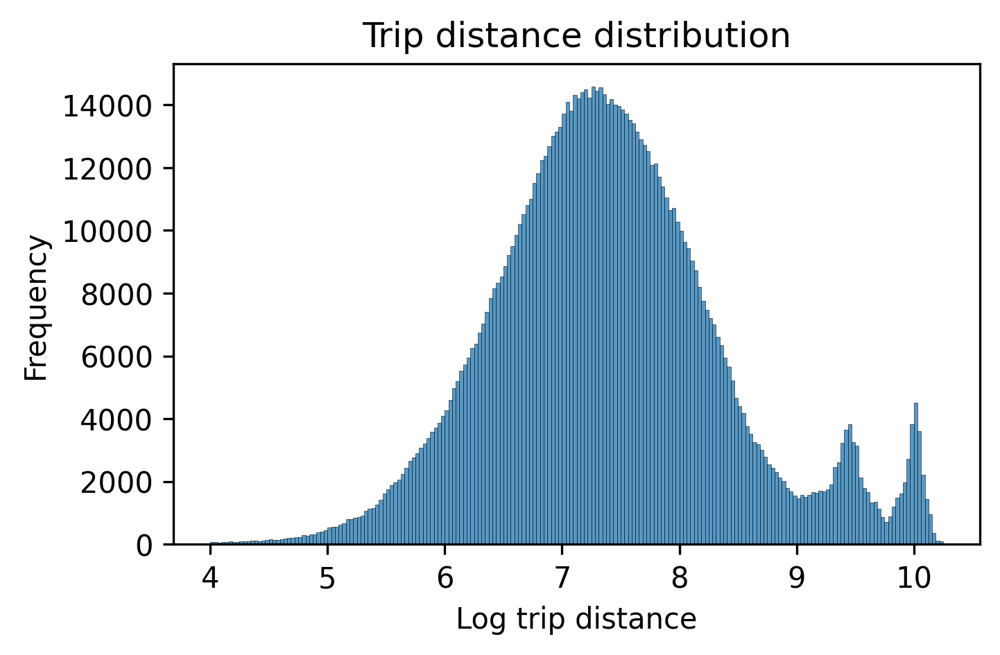

In [105]:
# После удаления
_, ax = plt.subplots(figsize=(5, 3), dpi=300)

plt.subplot(1, 1, 1)

sns.histplot(X_train["log_haversine"], bins=200)

plt.title("Trip distance distribution")

plt.ylabel("Frequency")
plt.xlabel("Log trip distance")


plt.show()

In [106]:
X_train["temp_log_trip_duration"] = y_train

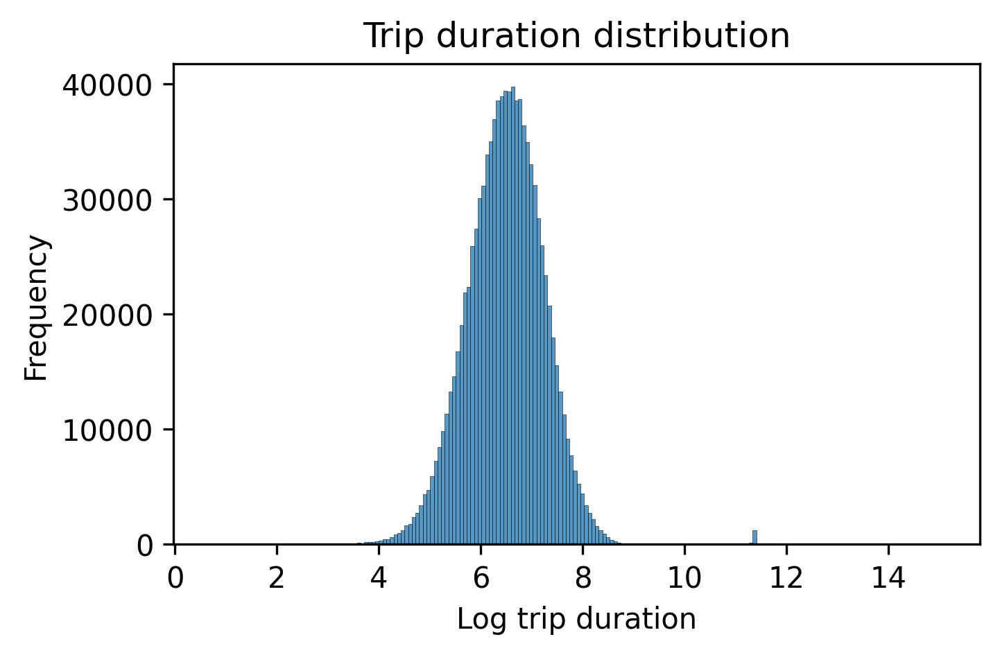

In [107]:
_, ax = plt.subplots(figsize=(5, 3), dpi=300)

plt.subplot(1, 1, 1)

sns.histplot(X_train["temp_log_trip_duration"], bins=200)

plt.title("Trip duration distribution")

plt.ylabel("Frequency")
plt.xlabel("Log trip duration")

plt.show()

In [108]:
X_train = X_train[(X_train["temp_log_trip_duration"] > 3.75) & (X_train["temp_log_trip_duration"] < 9)]

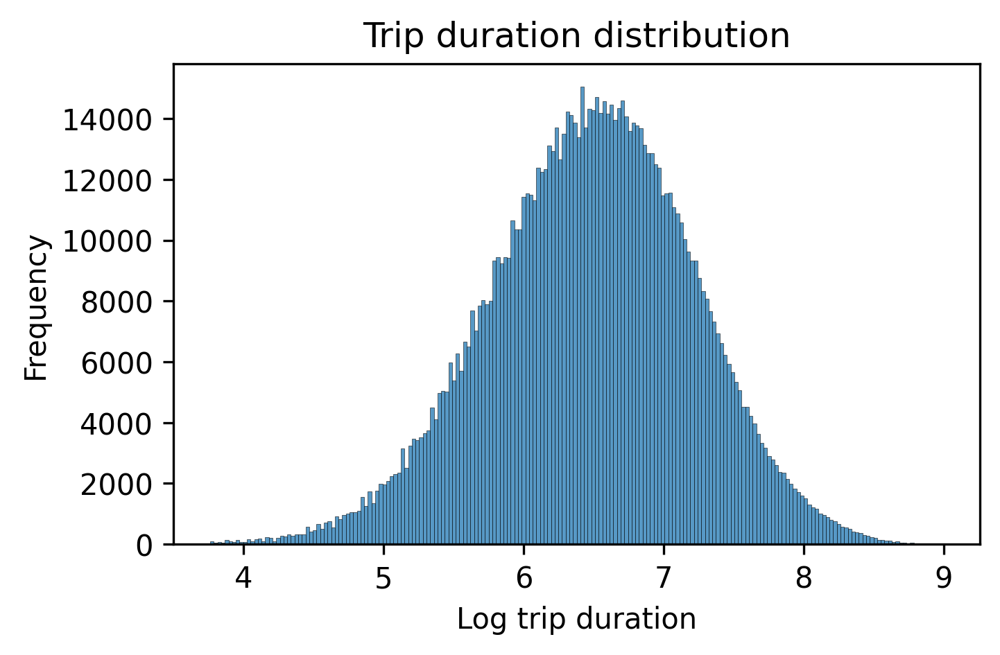

In [109]:
# После удаления
_, ax = plt.subplots(figsize=(5, 3), dpi=300)

plt.subplot(1, 1, 1)

sns.histplot(X_train["temp_log_trip_duration"], bins=200)

plt.title("Trip duration distribution")

plt.ylabel("Frequency")
plt.xlabel("Log trip duration")

plt.show()

In [110]:
if "temp_log_trip_duration" in X_train.columns:
    X_train = X_train.drop(columns=["temp_log_trip_duration"])

In [111]:
X_train["temp_residue"] = (ridge_regression.predict(X_train_encoded) - y_train) ** 2 # Надо взять модуль или квадрат ошибки. У меня MSE, поэтому возьму квадрат

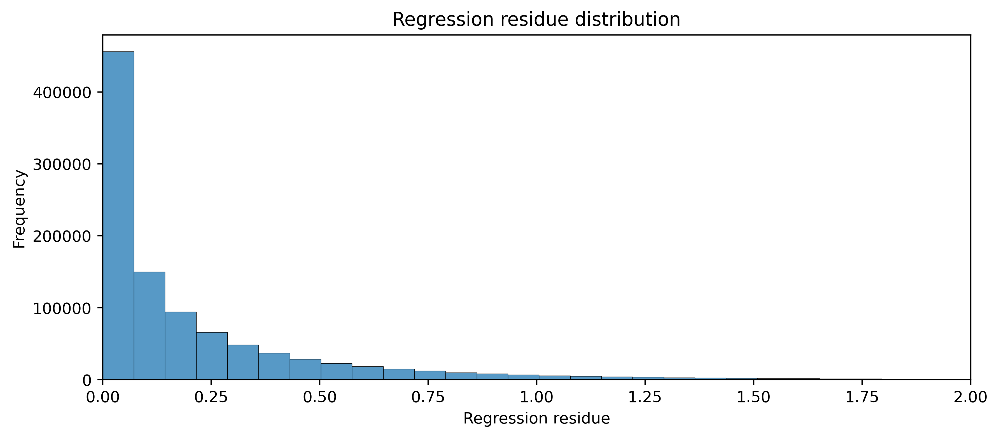

In [112]:
_, ax = plt.subplots(figsize=(10, 4), dpi=400)

plt.subplot(1, 1, 1)

sns.histplot(X_train["temp_residue"], bins=200)

plt.title("Regression residue distribution")

plt.ylabel("Frequency")
plt.xlabel("Regression residue")

plt.xlim(0, 2)

plt.show()

In [113]:
X_train = X_train[(X_train["temp_residue"] >= 0) & (X_train["temp_residue"] < 1)]

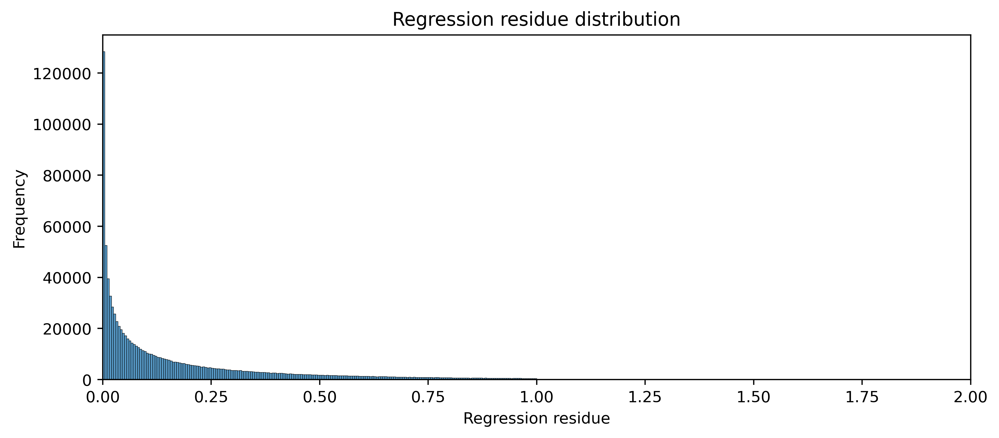

In [114]:
# После удаления
_, ax = plt.subplots(figsize=(10, 4), dpi=400)

plt.subplot(1, 1, 1)

sns.histplot(X_train["temp_residue"], bins=200)

plt.title("Regression residue distribution")

plt.ylabel("Frequency")
plt.xlabel("Regression residue")

plt.xlim(0, 2)

plt.show()

In [115]:
if "temp_residue" in X_train.columns:
    X_train = X_train.drop(columns=["temp_residue"])

Сейчас у нас очень много категориальных признаков. В категориальных признаках могут содержаться редкие категории, обычно это плохо: модель сильно переобучается на таких примерах. Для каждого категориального признака объедините действительно редкие категории в одну, если такие имеются (т.е. если категории действительно редкие).

In [116]:
X_train.select_dtypes(include=['category']).columns

Index(['month', 'dayofweek', 'hour', 'dayofyear', 'is_anomaly', 'is_jam',
       'is_free', 'is_pickup_JFK', 'is_dropoff_JFK', 'is_pickup_LGA',
       'is_dropoff_LGA', 'pickup_cell', 'dropoff_cell'],
      dtype='object')

In [117]:
X_train

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,month,dayofweek,hour,dayofyear,is_anomaly,log_haversine,is_jam,is_free,is_pickup_JFK,is_dropoff_JFK,is_pickup_LGA,is_dropoff_LGA,pickup_cell,dropoff_cell,target
55209,-73.968948,40.761173,-73.988464,40.743122,3,3,14,77,False,7.715650,True,False,False,False,False,False,3_2,2_1,7.063048
884486,-73.982498,40.765347,-73.999474,40.761353,5,6,10,150,False,7.546798,False,False,False,False,False,False,3_1,3_1,6.335054
321414,-73.991211,40.731628,-74.007294,40.707401,2,3,10,49,False,7.570205,True,False,False,False,False,False,2_1,1_1,7.074117
1341812,-73.982033,40.742386,-73.966270,40.761787,6,6,14,164,False,7.525205,False,False,False,False,False,False,2_1,3_2,6.865891
690582,-73.989174,40.739037,-73.946266,40.777065,3,3,18,77,False,8.500754,True,False,False,False,False,False,2_1,3_2,7.371489
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1310891,-74.001289,40.729256,-73.991241,40.750282,1,6,20,31,False,7.164207,False,False,False,False,False,False,2_1,3_1,6.565265
1454033,-74.015259,40.709389,-74.011528,40.708069,5,2,9,146,False,6.036138,True,False,False,False,False,False,-1,1_1,6.867974
233024,-73.994171,40.751026,-73.970390,40.768032,6,0,10,165,False,7.900753,True,False,False,False,False,False,3_1,3_2,6.863803
1190701,-73.865097,40.770668,-74.015816,40.708389,6,0,9,179,False,9.734370,True,False,False,False,True,False,-1,-1,7.569928


In [118]:
# Скорее всего проблема будет в категориальном признаке дней, в остальных как будто всё должно быть нормально. Посчитаю
categorical_columns = X_train.select_dtypes(include=['category']).columns

# Тут цикл не используется в обработке данных, просто для удобства. Это вообще было не обязательно писать... Пожалуйста....
for col in categorical_columns:
    print(f"Counts for {col}:")
    print(X_train[col].value_counts())
    print("\n")

Counts for month:
month
3    170641
4    167391
5    164634
2    159028
6    155493
1    153198
Name: count, dtype: int64


Counts for dayofweek:
dayofweek
4    148372
5    146669
3    144967
2    139640
1    135088
6    130179
0    125470
Name: count, dtype: int64


Counts for hour:
hour
19    60444
18    60373
20    56791
21    56241
22    53815
17    50701
14    49277
15    47484
13    47418
12    47412
23    46641
11    45594
9     44906
8     44597
10    43224
16    42386
7     36900
0     35287
1     25672
6     22353
2     18533
3     13908
4     10450
5      9978
Name: count, dtype: int64


Counts for dayofyear:
dayofyear
100    6590
65     6446
107    6387
72     6225
44     6207
       ... 
3      4284
25     4106
151    3697
24     2278
23     1062
Name: count, Length: 182, dtype: int64


Counts for is_anomaly:
is_anomaly
False    959242
True      11143
Name: count, dtype: int64


Counts for is_jam:
is_jam
True     501904
False    468481
Name: count, dtype: int64


Counts fo

Редкие будут Клетки вызова такси
Меньше сотни:
2_6        81
3_5        55
8_6        54
7_6        47
3_7        32
3_6        26
1_7        23
2_7        19
7_7        10
8_7         2
8_2         1
7_1         0
И приезда такси
Также меньше сотки
7_7        94
3_6        54
7_1        22
8_7         9
8_1         4
8_2         4
Не стану их объединять, так как они не соседи
А при уменьшении количества клеток разбиение нравится мне меньше (клетки слишком большие)
так что это оптимальный вариант
Ситуация с днями оказалась не такой плохой, как я думал. В день было от 6580  1063 вызовов.
Их стоило бы объединить в недели (ещё в первых задания, с помощью pandas.mestamp.week), но это видимо уже относится к бонусному заданию.
Также объединю редки ночные часы в одну категорию (3, 4, 5)
Остальное вроде нормально

In [119]:
X_train.loc[:, 'hour'] = X_train['hour'].apply(lambda h: 345 if h in {3, 4, 5} else h)
# X_train.loc[:, 'week'] = (X_train['dayofyear'].astype(int) // 7)

X_test.loc[:, 'hour'] = X_test['hour'].apply(lambda h: 345 if h in {3, 4, 5} else h)
# X_test.loc[:, 'week'] = (X_test['dayofyear'].astype(int) // 7)

<ipython-input-119-85a1daf0c5d8>:1: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[14 10 10 ... 10  9 16]' has dtype incompatible with category, please explicitly cast to a compatible dtype first.
  X_train.loc[:, 'hour'] = X_train['hour'].apply(lambda h: 345 if h in {3, 4, 5} else h)
<ipython-input-119-85a1daf0c5d8>:4: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ 1 14 18 ... 13 13  7]' has dtype incompatible with category, please explicitly cast to a compatible dtype first.
  X_test.loc[:, 'hour'] = X_test['hour'].apply(lambda h: 345 if h in {3, 4, 5} else h)


In [120]:
X_train.dtypes

,0
pickup_longitude,float64
pickup_latitude,float64
dropoff_longitude,float64
dropoff_latitude,float64
month,category
dayofweek,category
hour,int32
dayofyear,category
is_anomaly,category
log_haversine,float64


Обучите модель на очищенных данных и посчитайте качество на тестовой выборке.

In [121]:
X_train["hour"] = X_train["hour"].astype("category")
# X_train["week"] = X_train["week"].astype("category")

In [122]:
X_train

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,month,dayofweek,hour,dayofyear,is_anomaly,log_haversine,is_jam,is_free,is_pickup_JFK,is_dropoff_JFK,is_pickup_LGA,is_dropoff_LGA,pickup_cell,dropoff_cell,target
55209,-73.968948,40.761173,-73.988464,40.743122,3,3,14,77,False,7.715650,True,False,False,False,False,False,3_2,2_1,7.063048
884486,-73.982498,40.765347,-73.999474,40.761353,5,6,10,150,False,7.546798,False,False,False,False,False,False,3_1,3_1,6.335054
321414,-73.991211,40.731628,-74.007294,40.707401,2,3,10,49,False,7.570205,True,False,False,False,False,False,2_1,1_1,7.074117
1341812,-73.982033,40.742386,-73.966270,40.761787,6,6,14,164,False,7.525205,False,False,False,False,False,False,2_1,3_2,6.865891
690582,-73.989174,40.739037,-73.946266,40.777065,3,3,18,77,False,8.500754,True,False,False,False,False,False,2_1,3_2,7.371489
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1310891,-74.001289,40.729256,-73.991241,40.750282,1,6,20,31,False,7.164207,False,False,False,False,False,False,2_1,3_1,6.565265
1454033,-74.015259,40.709389,-74.011528,40.708069,5,2,9,146,False,6.036138,True,False,False,False,False,False,-1,1_1,6.867974
233024,-73.994171,40.751026,-73.970390,40.768032,6,0,10,165,False,7.900753,True,False,False,False,False,False,3_1,3_2,6.863803
1190701,-73.865097,40.770668,-74.015816,40.708389,6,0,9,179,False,9.734370,True,False,False,False,True,False,-1,-1,7.569928


In [123]:
# Верну изменённый y
y_train = X_train["target"]
if "target" in X_train.columns:
    X_train = X_train.drop(columns=["target"])

In [124]:
gc.collect()

15820

In [125]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer


category_columns = X_train.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['category']).columns
numerical_columns = X_train.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['float64', 'int64']).columns

# Трансформер, чтобы обрабатывать только категориальные признаки
ohe_preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown="ignore"), category_columns), # sparse_output=False
        # Дропаю первый, чтобы не было мультиколлинеарности
        # ignore - игнорировать неизвестные категории (все столбцы False)
        ('num', StandardScaler(), numerical_columns)
    ],
    remainder='passthrough'
)

X_train_encoded = ohe_preprocessor.fit_transform(X_train)
X_test_encoded = ohe_preprocessor.transform(X_test)

column_names = list(map(lambda name: name.split("__")[1], ohe_preprocessor.get_feature_names_out()))

X_train_encoded = pd.DataFrame.sparse.from_spmatrix(X_train_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])
X_test_encoded = pd.DataFrame.sparse.from_spmatrix(X_test_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])

display(X_train_encoded.sample(5))
display(X_test_encoded.sample(5))

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [5, 6, 7, 8, 9, 10] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,dropoff_cell_2_1,dropoff_cell_2_2,dropoff_cell_2_3,dropoff_cell_3_1,dropoff_cell_3_2,dropoff_cell_3_3,dropoff_cell_4_1,dropoff_cell_4_2,dropoff_cell_4_3,log_haversine
605030,0,1.0,0,0,0,0,0,0,0,0,...,0,0,0,0,1.0,0,0,0,0,1.192162
201684,0,0,0,0,1.0,0,0,0,1.0,0,...,1.0,0,0,0,0,0,0,0,0,-0.698308
444027,0,0,0,0,1.0,0,0,1.0,0,0,...,0,0,0,1.0,0,0,0,0,0,-0.439641
880821,0,0,0,0,1.0,0,0,1.0,0,0,...,1.0,0,0,0,0,0,0,0,0,-0.301063
591451,0,0,1.0,0,0,0,0,0,0,1.0,...,0,0,1.0,0,0,0,0,0,0,0.684776


,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,dropoff_cell_2_1,dropoff_cell_2_2,dropoff_cell_2_3,dropoff_cell_3_1,dropoff_cell_3_2,dropoff_cell_3_3,dropoff_cell_4_1,dropoff_cell_4_2,dropoff_cell_4_3,log_haversine
179013,0,0,0,1.0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2.161927
85455,0,0,1.0,0,0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,1.0,0,0.928887
436169,0,0,0,1.0,0,0,0,0,1.0,0,...,0,0,0,0,1.0,0,0,0,0,-1.633652
21553,0,0,1.0,0,0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,0,0,-0.024405
331947,0,0,0,0,0,0,0,1.0,0,0,...,0,0,0,0,1.0,0,0,0,0,0.542353


In [126]:
from sklearn.linear_model import Ridge


ridge_regression = Ridge()

ridge_regression.fit(X=X_train_encoded, y=y_train)

train_pred = ridge_regression.predict(X_train_encoded)
test_pred = ridge_regression.predict(X_test_encoded)

In [127]:
# const: 0.7957592365411509

# Прошлое:
# Train rmsle: {0.5500845582475353}
# Test rmsle: {0.5582246191426582}

print("Train rmsle:", {rmsle(y_train, train_pred)})
print("Test rmsle:", {rmsle(y_test, test_pred)})

# Стало только хуже! Видимо удалил слишком много

Train rmsle: {0.40947323602010083}
Test rmsle: {0.5738055125868261}


**Задание 14 (1 балл)**. После OneHot-кодирования количество признаков в нашем датасете сильно возрастает. Посчитайте колиество признаков до и после кодирования категориальных признаков.

In [128]:
print("До:", X_train.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).shape[1])
print("До:", X_train_encoded.shape[1])

До: 14
До: 245


Попробуйте обучить не `Ridge`-, а `Lasso`-регрессию. Какой метод лучше?

In [129]:
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso


ridge_regression = Ridge()
lasso_regression = Lasso()

ridge_regression.fit(X=X_train_encoded, y=y_train)
lasso_regression.fit(X=X_train_encoded, y=y_train)

train_pred_r = ridge_regression.predict(X_train_encoded)
test_pred_r = ridge_regression.predict(X_test_encoded)

train_pred_l = lasso_regression.predict(X_train_encoded)
test_pred_l = lasso_regression.predict(X_test_encoded)

In [130]:
# Train rmsle: {0.40947323602010083}
# Test rmsle: {0.5738055125868261}
print("Ridge train rmsle:", {rmsle(y_train, train_pred_r)})
print("Ridge test rmsle:", {rmsle(y_test, test_pred_r)})

print("Lasso train rmsle:", {rmsle(y_train, train_pred_l)})
print("Lasso test rmsle:", {rmsle(y_test, test_pred_l)})


Ridge train rmsle: {0.40947323602010083}
Ridge test rmsle: {0.5738055125868261}
Lasso train rmsle: {0.6817324941559483}
Lasso test rmsle: {0.7953605964873116}


В моём случае Лассо работает намного хуже. Скорее всего у него плохие гиперпараметры. Ну или просто для данной задачи не выгодно занулять фичи

Разбейте _обучающую выборку_ на обучающую и валидационную в отношении 8:2. По валидационной выборке подберите оптимальные значения параметра регуляризации (по логарифмической сетке) для `Ridge` и `Lasso`, на тестовой выборке измерьте качество лучшей полученной модели.

In [131]:

# Буду опять стратифицировать по бинам
y_train_bins = pd.qcut(x=y_train, q=10, labels=False, duplicates="drop")

X_train_train, X_val, y_train_train, y_val = train_test_split(X_train, y_train, test_size=0.2, stratify=y_train_bins, random_state=123)

In [132]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer


category_columns = X_train_train.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['category']).columns
numerical_columns = X_train_train.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['float64', 'int64']).columns

# Трансформер, чтобы обрабатывать только категориальные признаки
ohe_preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown="ignore"), category_columns), # sparse_output=False
        # Дропаю первый, чтобы не было мультиколлинеарности
        # ignore - игнорировать неизвестные категории (все столбцы False)
        ('num', StandardScaler(), numerical_columns)
    ],
    remainder='passthrough'
)

X_train_train_encoded = ohe_preprocessor.fit_transform(X_train_train)
X_val_encoded = ohe_preprocessor.transform(X_val)

column_names = list(map(lambda name: name.split("__")[1], ohe_preprocessor.get_feature_names_out()))

X_train_train_encoded = pd.DataFrame.sparse.from_spmatrix(X_train_train_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])
X_val_encoded = pd.DataFrame.sparse.from_spmatrix(X_val_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])

display(X_train_train_encoded.sample(5))
display(X_val_encoded.sample(5))

,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,dropoff_cell_2_1,dropoff_cell_2_2,dropoff_cell_2_3,dropoff_cell_3_1,dropoff_cell_3_2,dropoff_cell_3_3,dropoff_cell_4_1,dropoff_cell_4_2,dropoff_cell_4_3,log_haversine
32642,0,0,1.0,0,0,1.0,0,0,0,0,...,0,0,0,0,1.0,0,0,0,0,-0.01303
559960,0,0,0,0,0,0,0,0,0,1.0,...,0,0,0,0,0,0,1.0,0,0,2.563742
525775,1.0,0,0,0,0,0,1.0,0,0,0,...,1.0,0,0,0,0,0,0,0,0,1.020327
104165,0,0,0,1.0,0,1.0,0,0,0,0,...,0,0,0,0,1.0,0,0,0,0,-1.239106
410958,0,0,1.0,0,0,0,0,0,0,1.0,...,0,0,0,0,0,0,0,0,0,2.628075


,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,dropoff_cell_2_1,dropoff_cell_2_2,dropoff_cell_2_3,dropoff_cell_3_1,dropoff_cell_3_2,dropoff_cell_3_3,dropoff_cell_4_1,dropoff_cell_4_2,dropoff_cell_4_3,log_haversine
97055,0,0,0,1.0,0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,0,0,-0.76728
146717,0,0,0,1.0,0,0,0,0,0,0,...,0,0,0,1.0,0,0,0,0,0,-1.96177
184314,0,0,0,0,1.0,0,0,0,0,0,...,0,0,0,0,1.0,0,0,0,0,0.317324
100795,0,1.0,0,0,0,0,1.0,0,0,0,...,0,0,0,0,1.0,0,0,0,0,1.851249
193251,1.0,0,0,0,0,0,0,0,1.0,0,...,1.0,0,0,0,0,0,0,0,0,-0.4243


In [133]:
# Логарифмическую сетку буду перебирать с помощью цикла, так как иной реализации не существует)
ridge_rmsle, lasso_rmsle = [], []
zeroes_lasso = []

for a in np.logspace(-4, 3, num=8):
    ridge_regression = Ridge(alpha=a)
    lasso_regression = Lasso(alpha=a)

    ridge_regression.fit(X=X_train_train_encoded, y=y_train_train)
    lasso_regression.fit(X=X_train_train_encoded, y=y_train_train)

    val_pred_r = ridge_regression.predict(X_val_encoded)

    val_pred_l = lasso_regression.predict(X_val_encoded)

    ridge_rmsle.append(rmsle(y_val, val_pred_r))
    lasso_rmsle.append(rmsle(y_val, val_pred_l))

    zeroes_lasso.append(np.sum(lasso_regression.coef_ == 0))

In [134]:
print(f"best rmsle for ridge regression = {min(ridge_rmsle)} with alpha = {np.logspace(-4, 3, num=8)[np.argmin(ridge_rmsle)]}")
print(f"best rmsle for lasso regression = {min(lasso_rmsle)} with alpha = {np.logspace(-4, 3, num=8)[np.argmin(lasso_rmsle)]}")

best rmsle for ridge regression = 0.40972879265046097 with alpha = 100.0
best rmsle for lasso regression = 0.41010826157594704 with alpha = 0.0001


Сохраните наилучшее значение, как бенчмарк на будущее

In [135]:
# Обучу итоговую модель по всей выборке
ridge_regression = Ridge(alpha=np.logspace(-4, 3, num=8)[np.argmin(ridge_rmsle)])



ridge_regression.fit(X=X_train_encoded, y=y_train)

train_pred = ridge_regression.predict(X_train_encoded)
test_pred = ridge_regression.predict(X_test_encoded)

In [136]:
# Прошлое:
# Ridge train rmsle: {0.40947323602010083}
# Ridge test rmsle: {0.5738055125868261}

print("Train rmsle:", {rmsle(y_train, train_pred)})
print("Test rmsle:", {rmsle(y_test, test_pred)})

# Стало ещё немного хуже, потихоньку возвращаю модель к константной

Train rmsle: {0.4094854306647356}
Test rmsle: {0.5739281418071461}


Для каждого перебранного `alpha` для Lasso посчитайте количество нулевых весов в модели и нарисуйте график зависимости его от `alpha`. Как сильно придётся потерять в качестве, если мы хотим с помощью Lasso избавиться хотя бы от половины признаков?

In [137]:
zeroes_lasso

[89, 206, 236, 244, 245, 245, 245, 245]

In [138]:
np.logspace(-4, 3, num=8)

array([1.e-04, 1.e-03, 1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03])

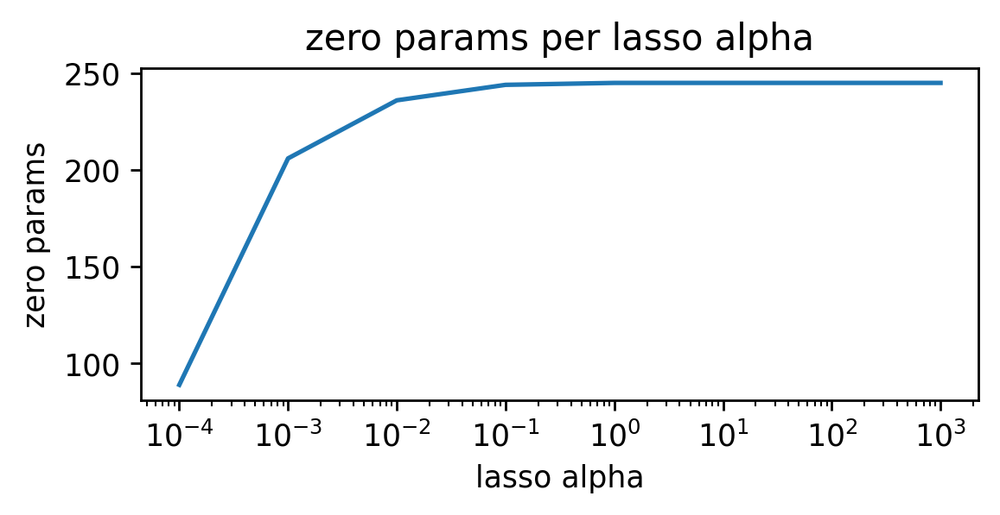

In [139]:
_, ax = plt.subplots(figsize=(5, 2), dpi=250)

sns.lineplot(x=np.logspace(-4, 3, num=8), y=zeroes_lasso, ax=ax)

ax.set_title("zero params per lasso alpha")

ax.set_ylabel("zero params")
ax.set_xlabel("lasso alpha")
ax.set_xscale('log')

plt.show()

In [140]:
print("Всего признаков: ", X_train_encoded.shape[1])

lasso_regression = Lasso(alpha=np.logspace(-4, 3, num=8)[np.argmin(lasso_rmsle)])
lasso_regression.fit(X=X_train_encoded, y=y_train)
test_pred = lasso_regression.predict(X_test_encoded)
print("Качество с нормальным alpha на тесте:", rmsle(y_test, test_pred) )

lasso_regression = Lasso(alpha=0.001)
lasso_regression.fit(X=X_train_encoded, y=y_train)
test_pred = lasso_regression.predict(X_test_encoded)
print("Качество на тесте если удалить половину признаков:", rmsle(y_test, test_pred))

Всего признаков:  245
Качество с нормальным alpha на тесте: 0.5751864376416361
Качество на тесте если удалить половину признаков: 0.5842025701392544


In [141]:
best_rmsle = rmsle(y_test, test_pred)

Качество станет всего на 0.01 хуже. Из этого можно сделать вывод, что больше половины признаков (206 из 245) практически не несут никакой информации.

<img src="https://www.dropbox.com/s/wp4jj0599np17lh/map_direction.png?raw=1" width="20%" align="right" style="margin-left: 20px">

**Задание 15 (1 балл)**. Часто бывает полезным использовать взаимодействия признаков (feature interactions), то есть строить новые признаки на основе уже существующих. Выше мы разбили карту Манхэттена на ячейки и придумали признаки "из какой ячейки началась поездка" и "в какой ячейке закончилась поездка".

Давайте попробуем сделать следующее: посчитаем, сколько раз встречается каждая возможная пара этих признаков в нашем датасете и выберем 100 самых частых пар. Закодируем поездки с этими частыми парами как категориальный признак, остальным объектам припишем -1. Получается, что мы закодировали, откуда и куда должно было ехать такси.

**Вопрос**: Почему такой признак потенциально полезный? Почему линейная модель не может самостоятельно "вытащить" эту информацию, ведь у нее в распоряжении есть признаки "из какой ячейки началась поездка" и "в какой ячейке закончилась поездка"?

**Ответ**: Линейная модель, в отличии от каких-нибудь деревьев, не может "замечать" влияния комбинации признаков. Каждый признак прибавляет своё значение к ответу.

In [142]:
X_train["from_to"] = X_train['pickup_cell'].astype(str) + '_' + X_train['dropoff_cell'].astype(str)
X_test["from_to"] = X_test['pickup_cell'].astype(str) + '_' + X_test['dropoff_cell'].astype(str)

In [143]:
# Обучаю на трейне
pair_amount = X_train["from_to"].groupby(X_train["from_to"]).count()

In [144]:
top_100_set = set(pair_amount.sort_values(ascending=False).index[:100]) # 100 самых частых

In [145]:
# get_top_100 = np.vectorize(lambda x: x if x in top_100_set else -1)
X_train["from_to"] = np.where(X_train["from_to"].isin(top_100_set), X_train["from_to"], '-1')
X_test["from_to"] = np.where(X_test["from_to"].isin(top_100_set), X_test["from_to"], '-1')

In [146]:
X_train.sample(10)

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,month,dayofweek,hour,dayofyear,is_anomaly,log_haversine,is_jam,is_free,is_pickup_JFK,is_dropoff_JFK,is_pickup_LGA,is_dropoff_LGA,pickup_cell,dropoff_cell,from_to
994674,-73.988739,40.747887,-74.087257,40.613647,3,1,14,68,False,9.368425,True,False,False,False,False,False,2_1,-1,2_1_-1
1335714,-73.790497,40.643700,-73.930458,40.761452,2,6,17,59,False,9.680457,False,False,True,False,False,False,-1,3_3,-1_3_3
769857,-73.983292,40.734203,-74.010086,40.719738,5,5,19,135,False,8.011885,True,False,False,False,False,False,2_1,2_1,2_1_2_1
934771,-73.982117,40.779175,-73.952522,40.800495,2,4,15,50,False,8.119700,True,False,False,False,False,False,4_1,4_2,4_1_4_2
1242051,-73.991615,40.749577,-73.940994,40.697910,1,4,0,22,False,8.675178,False,False,False,False,False,False,3_1,1_2,3_1_1_2
40232,-74.006874,40.730392,-73.854469,40.721718,4,2,21,111,False,9.739127,False,False,False,False,False,False,2_1,-1,2_1_-1
653336,-73.989311,40.736092,-73.975891,40.776211,4,5,13,121,False,7.569201,True,False,False,False,False,False,2_1,3_1,2_1_3_1
446834,-73.991333,40.749836,-73.969032,40.765892,3,6,14,73,False,7.836778,False,False,False,False,False,False,3_1,3_2,3_1_3_2
919111,-73.988068,40.759583,-73.977097,40.782497,1,4,23,15,False,7.251772,False,False,False,False,False,False,3_1,4_1,3_1_4_1
554174,-73.976067,40.791492,-73.957123,40.782665,6,1,18,166,False,7.662565,True,False,False,False,False,False,4_1,4_2,4_1_4_2


Заново обучите модель (`Ridge`, если она дала более высокое качество в предыдущих экспериментах, и `Lasso` иначе) на новых даннных и посчитайте качество на тестовой выборке

In [147]:
X_train.dtypes

,0
pickup_longitude,float64
pickup_latitude,float64
dropoff_longitude,float64
dropoff_latitude,float64
month,category
dayofweek,category
hour,category
dayofyear,category
is_anomaly,category
log_haversine,float64


In [148]:
X_train["from_to"] = X_train["from_to"].astype("category")

In [149]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
# Для начала нужно снова закодировать параметры

category_columns = X_train.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['category']).columns
numerical_columns = X_train.drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"]).select_dtypes(include=['float64', 'int64']).columns

# Трансформер, чтобы обрабатывать только категориальные признаки
ohe_preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown="ignore"), category_columns), # sparse_output=False
        # Дропаю первый, чтобы не было мультиколлинеарности
        # ignore - игнорировать неизвестные категории (все столбцы False)
        ('num', StandardScaler(), numerical_columns)
    ],
    remainder='passthrough'
)

X_train_encoded = ohe_preprocessor.fit_transform(X_train)
X_test_encoded = ohe_preprocessor.transform(X_test)

column_names = list(map(lambda name: name.split("__")[1], ohe_preprocessor.get_feature_names_out()))

X_train_encoded = pd.DataFrame.sparse.from_spmatrix(X_train_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])
X_test_encoded = pd.DataFrame.sparse.from_spmatrix(X_test_encoded, columns=column_names).drop(columns=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude"])

display(X_train_encoded.sample(5))
display(X_test_encoded.sample(5))

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [5, 6, 7, 8, 9, 10] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,from_to_4_2_1_1,from_to_4_2_2_1,from_to_4_2_2_2,from_to_4_2_3_1,from_to_4_2_3_2,from_to_4_2_3_3,from_to_4_2_4_1,from_to_4_2_4_2,from_to_4_2_4_3,log_haversine
444009,0,0,0,1.0,0,0,1.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0.463621
898304,0,0,0,1.0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1.113055
145175,0,0,1.0,0,0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,0,0,1.91003
547528,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,-0.264254
769479,0,0,1.0,0,0,0,1.0,0,0,0,...,0,0,0,0,0,0,0,0,0,2.064518


,month_2,month_3,month_4,month_5,month_6,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,from_to_4_2_1_1,from_to_4_2_2_1,from_to_4_2_2_2,from_to_4_2_3_1,from_to_4_2_3_2,from_to_4_2_3_3,from_to_4_2_4_1,from_to_4_2_4_2,from_to_4_2_4_3,log_haversine
301039,0,0,1.0,0,0,0,0,0,0,1.0,...,0,0,0,0,0,0,0,0,0,0.375616
398383,0,1.0,0,0,0,0,0,0,0,1.0,...,0,0,0,0,0,0,0,0,0,-0.842858
300879,0,0,0,0,0,0,0,1.0,0,0,...,0,0,0,0,0,0,0,0,0,-0.299134
111216,0,0,0,0,0,0,0,0,0,1.0,...,0,0,0,0,0,0,0,0,0,-0.739781
193382,0,0,0,0,1.0,0,1.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0.794818


In [150]:
from sklearn.linear_model import Ridge


ridge_regression = Ridge(alpha=100)

ridge_regression.fit(X=X_train_encoded, y=y_train)

train_pred = ridge_regression.predict(X_train_encoded)
test_pred = ridge_regression.predict(X_test_encoded)

In [151]:
# const: 0.7957592365411509

# Прошлое:
# Train rmsle: {0.4094854306647356}
# Test rmsle: {0.5739281418071461}

print("Train rmsle:", {rmsle(y_train, train_pred)})
print("Test rmsle:", {rmsle(y_test, test_pred)})

# Стало на 0.02 лучше, нормальный признак

Train rmsle: {0.38882785657488167}
Test rmsle: {0.549064113261056}


**Задание 16 (бонус, 2 балла)**.

Разумеется, погружаться в feature engineering можно ещё очень долго. Ваша задача - придумать какие-то новые признаки, которые сделают модель ещё лучше!! За улучшение функционала ошибки на каждые 0.005 на тестовой выборке относительно `best_rmsle` будет даваться 0.5 бонусных балла. Всего за этот пункт можно получить до 2 бонусных баллов.

При построении признаков старайтесь не допустить утечки целевой переменной (подробнее про это можно почитать в материалах 1-го семинара) — в противном случае хорошего качества на тестовой выборке достичь не получится.

Какие могут быть идеи для вдохновения:

1. Трансформер, который строит разбиение карты по шестигранной решётке с помощью библиотеки [H3](https://github.com/uber/h3-py) и вычисляет признаки на основе такого разбиения, по аналогии с квадратной сеткой  
> Важно: производительность библиотеки существенно зависит от количества шестиугольников на карте (определяется параметром resolution). Подберите такое разрешение, при котором ваш код будет работать за приемлемое время.    

2. Мы пока что никак не использовали историчность и взаимосвязь в данных, хотя информация о том, что было ранее в эти/похожие дни тоже может пригодиться. Попробуйте поискать соседей и/или построить агрегации, например, при помощи groupby, посчитайте какие-либо статистики в пределах какого-то окна (подберите всё это сами, постарайтесь, чтобы это было что-то разумное), и присоедините к основному датафрейму
> Важно: учтите, что разных вариантов агрегаций и статистик существует очень много. Не стесняйтесь выкидывать фичи, которые вам не нравятся (помните про свойство Lasso), используйте эффективные способы хранения данных ([wink](https://www.kaggle.com/code/demche/polars-memory-usage-optimization)-[wink](https://docs.scipy.org/doc/scipy/reference/sparse.html))

3. В конце концов можно использовать альтернативные способы преобразования данных. Например, использовать другой scaler, другую кодировку категориальных фичей, другие гиперпараметры и пр. Но помните, что на данный момент мы ограничены только `Ridge` и `Lasso`

Для улучшения модели, увеличу количество ячеек для разбиения карты (в задании выше нужно было сделать 4 на 3). Также верну старую ridge регрессию без параметров. Посмотрю, поможет ли это. Если нет - воспользуюсь советами

In [154]:
transformer = MapGridTransformer(8, 7, 0.99, 0.03, 0.95, 0.01)

transformer.fit(X_train)

MapGridTransformer(height=9, quantile_bot=0.03, quantile_left=0.95,
                   quantile_right=0.01, quantile_top=0.99, width=8)

In [155]:
X_train["pickup_cell"], X_train["dropoff_cell"]  = transformer.transform(X_train)

In [156]:
X_test["pickup_cell"], X_test["dropoff_cell"]  = transformer.transform(X_test)

In [157]:
X_train["pickup_cell"] = X_train["pickup_cell"].astype("category")
X_train["dropoff_cell"] = X_train["dropoff_cell"].astype("category")
X_train["is_jam"] = X_train["is_jam"].astype("category")
X_train["is_free"] = X_train["is_free"].astype("category")
X_train["is_pickup_JFK"] = X_train["is_pickup_JFK"].astype("category")
X_train["is_dropoff_JFK"] = X_train["is_dropoff_JFK"].astype("category")
X_train["is_pickup_LGA"] = X_train["is_pickup_LGA"].astype("category")
X_train["is_dropoff_LGA"] = X_train["is_dropoff_LGA"].astype("category")

X_test["pickup_cell"] = X_test["pickup_cell"].astype("category")
X_test["dropoff_cell"] = X_test["dropoff_cell"].astype("category")
X_test["is_jam"] = X_train["is_jam"].astype("category")
X_test["is_free"] = X_train["is_free"].astype("category")
X_test["is_pickup_JFK"] = X_train["is_pickup_JFK"].astype("category")
X_test["is_dropoff_JFK"] = X_train["is_dropoff_JFK"].astype("category")
X_test["is_pickup_LGA"] = X_train["is_pickup_LGA"].astype("category")
X_test["is_dropoff_LGA"] = X_train["is_dropoff_LGA"].astype("category")


In [158]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer

# Удалю ещё 3 столбца, чтобы протестировать их в следующем задании

category_columns = X_train.select_dtypes(include=['category']).columns
numerical_columns = X_train.select_dtypes(include=['float64', 'int64']).columns

# Трансформер, чтобы обрабатывать только категориальные признаки
ohe_preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown="ignore"), category_columns), # sparse_output=False
        # Дропаю первый, чтобы не было мультиколлинеарности
        # ignore - игнорировать неизвестные категории (все столбцы False)
        ('num', StandardScaler(), numerical_columns)
    ],
    remainder='passthrough'
)

X_train_encoded = ohe_preprocessor.fit_transform(X_train)
X_test_encoded = ohe_preprocessor.transform(X_test)

column_names = list(map(lambda name: name.split("__")[1], ohe_preprocessor.get_feature_names_out()))

X_train_encoded = pd.DataFrame.sparse.from_spmatrix(X_train_encoded, columns=column_names)
X_test_encoded = pd.DataFrame.sparse.from_spmatrix(X_test_encoded, columns=column_names)

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [5, 6, 7, 8, 9, 10, 11] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [159]:
from sklearn.linear_model import Ridge


ridge_regression = Ridge()

ridge_regression.fit(X=X_train_encoded, y=y_train)

train_pred = ridge_regression.predict(X_train_encoded)
test_pred = ridge_regression.predict(X_test_encoded)

In [160]:
print("Test rmsle:", {rmsle(y_test, test_pred)})

Test rmsle: {0.5452574740699047}


In [161]:
best_rmsle

0.5842025701392544

In [170]:
print("бонусные баллы:", min(2, 0.5*(abs(best_rmsle - rmsle(y_test, test_pred))/0.005)))

бонусные баллы: 2
